<a href="https://colab.research.google.com/github/nilakshi104/Staircase-Segmentation/blob/master/Stair_Pose.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# dataroot='/content/drive/My Drive/stair_dataset/new_dataset/'
dataroot1='/content/drive/My Drive/Untitled folder/Stair dataset_final/val/'

In [ ]:
import os
import json
import cv2
from google.colab.patches import cv2_imshow
import numpy as np
from itertools import combinations
# from itertools import permutations
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from PIL import Image


#upper_left=(0,0)  upper_right=(640,0)  lower_left=(0,480)  lower_right=(640,480) for images from labelme

In [ ]:
def PolygonArea(corners):
    n = len(corners) # of corners
    area = 0.0
    for i in range(n):
        j = (i + 1) % n
        area += corners[i][0] * corners[j][1]
        area -= corners[j][0] * corners[i][1]
    area = abs(area) / 2.0
    return area

# PolygonArea([[0,0],[0,4],[4,4],[4,0]])

In [ ]:
# img_no='1000.png'
num=0
for img_no in os.listdir('/content/drive/My Drive/Untitled folder/Stair dataset_final/val'):
  num+=1
  class_pix=np.zeros([480,640],dtype='uint8')
  path1=dataroot1+img_no
  path2=dataroot1.rsplit('/',1)[0]+'_labels/'+img_no.split('.')[0]+'.json'
  temp1=json.load(open(path2))['shapes']

  # image=cv2.imread(path1)
  area2=0
  for i in range(len(json.load(open(path2))['shapes'])) :
    k=temp1[i]
    area1=PolygonArea(k['points'])
    if area1>area2:
      g=k['points']
    area2=area1
  for i in range(int(len(g)/2)):
    [x1,y1]=g[i]
    [x2,y2]=g[-i-1]
    class_pix = cv2.line(class_pix, (int(x1),int(y1)), (int(x2),int(y2)), (255,255,255), 4)
  im = Image.fromarray(class_pix)
  im.save(os.path.join('/content/drive/My Drive/Untitled folder/Stair dataset_final/val_masks1/',img_no.split('.')[0]+'_mask1.png'))
print(num)
  # index=np.reshape(np.array([0,0,255],dtype='uint8'),(1,1,3))
  # class_pix=np.zeros([480,640],dtype='uint8')
  # class_pix[(image==index)[:,:,0]]=255
# cv2_imshow(image) 
# cv2_imshow(class_pix) 


97


In [ ]:
num,img_no

(772, '.ipynb_checkpoints')

In [ ]:
  u
from PIL import Image

im = Image.fromarray(class_pix)
im.save(os.path.join('/content/drive/My Drive/Untitled folder/Stair dataset_final/val_masks/',img_no.split('.')[0]+'_mask.png'))


In [ ]:
 
list1=[]
for image in os.listdir(dataroot1):
    list1.append(image)

for i in list1:
  # lis t2=[]
  path1=dataroot1+i
  path2=dataroot1.rsplit('/',1)[0]+'_labels/'+i.split('.')[0]+'.json'
  temp1=json.load(open(path2))['shapes']
  image=cv2.imread(path1)
  area2=0
  for j in range(len(json.load(open(path2))['shapes'])) :
    k=temp1[j]
    area1=PolygonArea(k['points'])
    if area1>area2:
      g=k['points']
    area2=area1
  #g
  for n in range(int(len(g)/2)):
    [x1,y1]=g[n]
    [x2,y2]=g[-n-1]
    # list2.append([x1,y1,x2,y2])
  # dict1[i]=list2
# dict1
    image = cv2.line(image, (int(x1),int(y1)), (int(x2),int(y2)), (0,0,255), 2) 
  cv2_imshow(image)




In [ ]:
print(dict1['1329.png'])
print(len(dict1))

[[400.24873096446703, 238.57868020304568, 3.2944162436548226, 283.75634517766497], [361.16243654822335, 206.09137055837564, 3.8020304568527905, 223.85786802030458], [327.1522842639594, 180.71065989847716, 4.3096446700507585, 182.23350253807106], [297.2030456852792, 157.36040609137055, 5.324873096446709, 152.28426395939087], [269.79187817258884, 138.0710659898477, 4.817258883248726, 125.88832487309645], [248.97969543147207, 120.30456852791879, 5.324873096446709, 103.55329949238579], [224.61421319796955, 105.0761421319797, 5.324873096446709, 84.26395939086295], [206.84771573604064, 91.87817258883248, 4.3096446700507585, 70.55837563451777], [191.11167512690355, 79.69543147208122, 4.3096446700507585, 57.86802030456853], [175.88324873096445, 67.51269035532995, 3.8020304568527905, 47.71573604060914], [165.73096446700507, 60.40609137055838, 3.8020304568527905, 38.578680203045685], [152.0253807106599, 51.776649746192895, 3.2944162436548226, 30.456852791878173], [143.9035532994924, 44.162436548

In [ ]:

def get_intersection(i):
  x1=i[0][0]
  y1=i[0][1]
  x2=i[0][2]
  y2=i[0][3]
  x3=i[1][0]
  y3=i[1][1]
  x4=i[1][2]
  y4=i[1][3]
  if (x1-x2) ==0 or (x3-x4) ==0 :
    return(0,0)
  else:
    b=(y1-y2)/(x1-x2)
    a=(y3-y4)/(x3+x4)
    a1=(y3-a*x3)
    b1=(y1-b*x1)
    if (b-a) ==0 :
      return (0,0)
    else:
      X=(a1-b1)/(b-a)
      Y=b*(X-x1)+y1
      return (X,Y)
   
  
for i in list1:
  p=dict1[i]
  comb=combinations(p,2)
  x0=0
  y0=0
  count=0
  for i in comb:
    # print(i)
    if get_intersection(i)==(0,0):
      count-=1
    else:
      x0+=get_intersection(i)[0]
      y0+=get_intersection(i)[1]
      count+=1
  x_mean=x0/count
  y_mean=y0/count
  print(x_mean)
  print(y_mean)

-285.32623902267534
146.50384601897085
1801.309726511799
128.2968868831149
-323.957070530369
201.8139206355911
116.1809370001455
126.78313644924977
676.9299204436725
215.79483315096542
-110.52010047418936
159.08283064834706
-1527.1284907295185
136.02506550598451
369.7903938352357
36.89314508079042
3138.6458813142294
122.71868787986918
615.8226451243833
216.11666681567826
-3295.7132528887155
131.75415876454892
-7564.558866420927
100.76112164239973
176.58283539277434
119.52418090478528
-3111.614976776189
26.35702047758149
1506.1076248394472
192.11531806138598
-206.0755152495952
67.14810118038986
-1086.1745762290002
140.69661500729987
4877.094909847265
341.7069633365442
-8241.300203007391
314.62309019385197
5655.917521497009
162.36297894240099
7151.300056733221
308.632095084556
644.8803573924065
205.1085661503192
-259.7337698248566
334.7658537317719
986.8864768553316
219.65433207908015
697.5038360045494
115.04408143763136
-3263.1396212290406
145.9263620664672
-316.6147807042664
97.8693005

The linear model is: Y = -63.259 + 0.74735X
The linear model is: Y = 103.5 + 0.0X


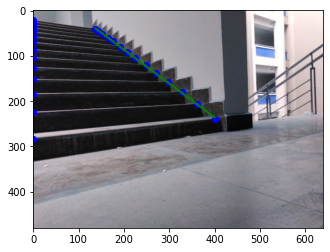

The linear model is: Y = 1.4182e+04 + -51.854X
The linear model is: Y = 383.32 + -1.4703X


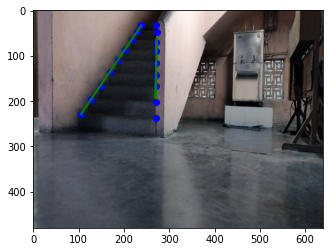

The linear model is: Y = 873.57 + -1.3613X
The linear model is: Y = 351.8 + -0.70539X


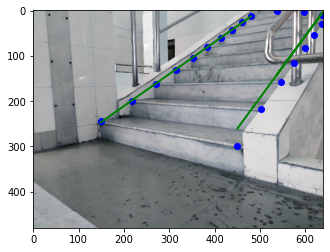

The linear model is: Y = -668.76 + 1.413X
The linear model is: Y = 1596.3 + -7.727X


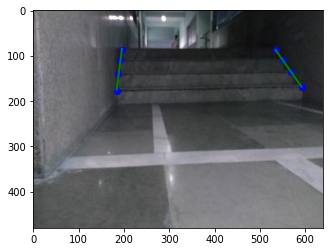

The linear model is: Y = -564.4 + 1.8317X
The linear model is: Y = 2311.7 + -8.264X


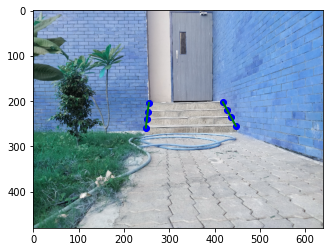

The linear model is: Y = -414.56 + 1.2852X
The linear model is: Y = -5737.1 + 45.65X


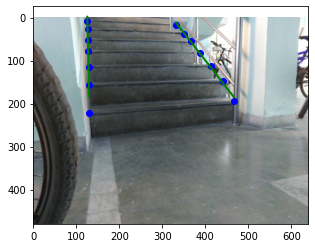

The linear model is: Y = -177.39 + 0.89086X
The linear model is: Y = 785.39 + -2.3554X


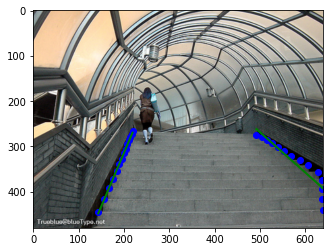

The linear model is: Y = -464.57 + 1.2938X
The linear model is: Y = 531.65 + -4.0385X


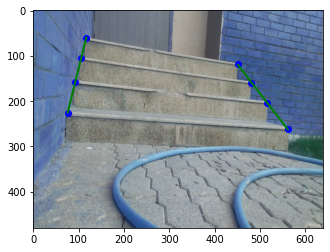

The linear model is: Y = -6098.8 + 13.429X
The linear model is: Y = 412.98 + -1.1728X


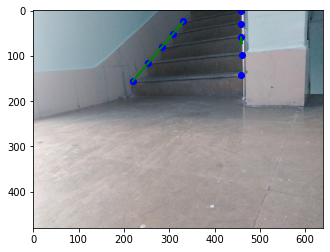

The linear model is: Y = 1.0707e+04 + -16.5X
The linear model is: Y = 180.32 + -0.71953X


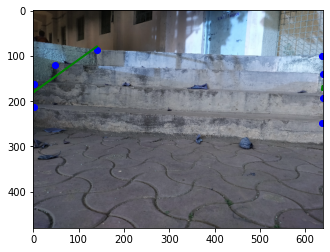

The linear model is: Y = -328.61 + 1.0393X
The linear model is: Y = 329.45 + -0.8265X


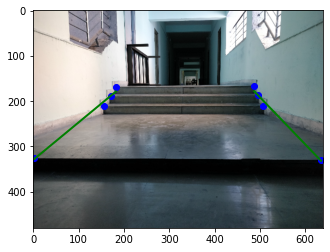

The linear model is: Y = 1920.3 + -3.0428X
The linear model is: Y = 286.47 + -0.76971X


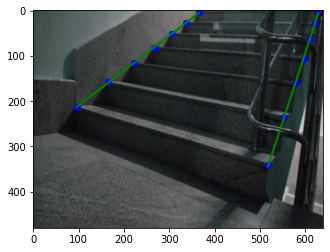

The linear model is: Y = 4469.1 + -10.403X
The linear model is: Y = 585.76 + -1.9477X


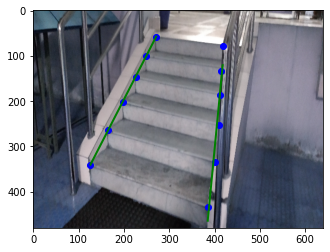

The linear model is: Y = -1.7696e+05 + 278.0X
The linear model is: Y = 330.26 + -0.95892X


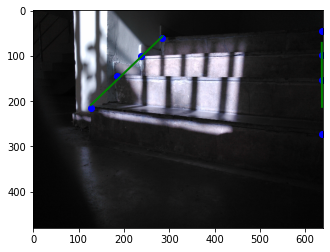

The linear model is: Y = -198.15 + 0.59394X
The linear model is: Y = 198.09 + -1.1885X


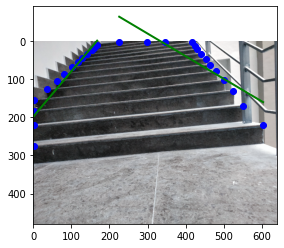

The linear model is: Y = -1042.1 + 3.1212X
The linear model is: Y = 502.27 + -3.0X


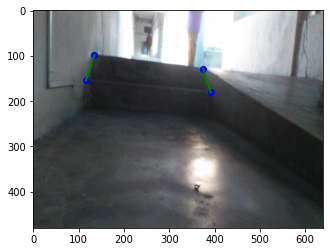

The linear model is: Y = -1939.6 + 4.4123X
The linear model is: Y = 249.51 + -63.058X


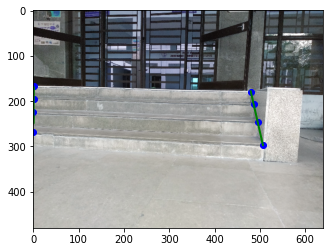

The linear model is: Y = -6803.6 + 11.591X
The linear model is: Y = 230.79 + -0.89141X


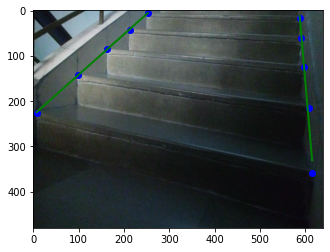

The linear model is: Y = -555.11 + 1.3454X
The linear model is: Y = 394.05 + -4.6107X


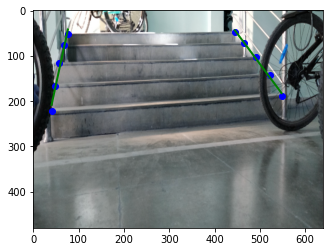

The linear model is: Y = -1.3022e+05 + 204.25X
The linear model is: Y = 253.96 + -16.389X


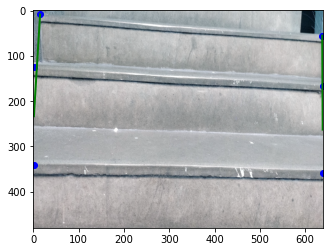

The linear model is: Y = -445.91 + 1.2014X
The linear model is: Y = 325.04 + -1.0031X


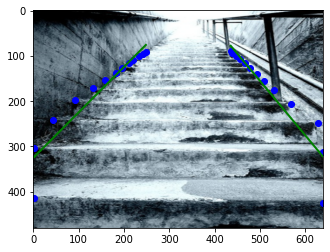

The linear model is: Y = 2137.8 + -3.2024X
The linear model is: Y = 300.03 + -0.38648X


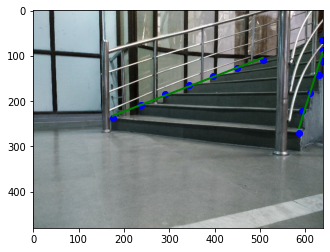

The linear model is: Y = -423.83 + 1.617X
The linear model is: Y = 1.0795e+04 + -44.0X


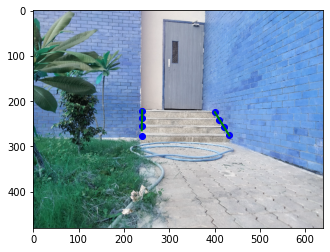

The linear model is: Y = -799.08 + 1.5778X
The linear model is: Y = 628.75 + -2.185X


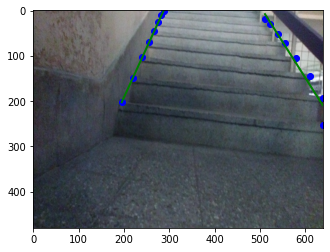

The linear model is: Y = 34.552 + 0.23728X
The linear model is: Y = 312.02 + -2.3376X


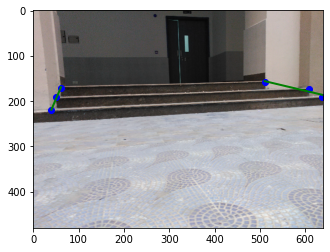

The linear model is: Y = 471.37 + -0.86732X
The linear model is: Y = 4470.8 + -16.179X


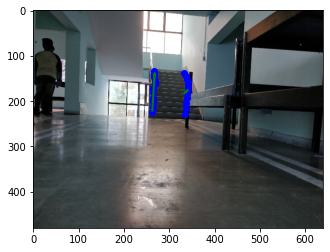

The linear model is: Y = -3.8113e+04 + 59.929X
The linear model is: Y = 1398.9 + -2.6945X


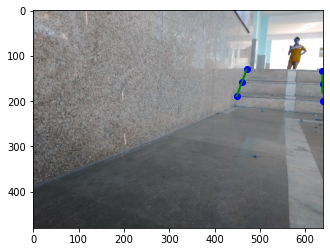

The linear model is: Y = -47.022 + 0.51307X
The linear model is: Y = 616.85 + -4.8953X


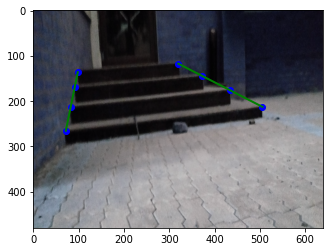

The linear model is: Y = -274.06 + 0.55762X
The linear model is: Y = 617.28 + -1.5457X


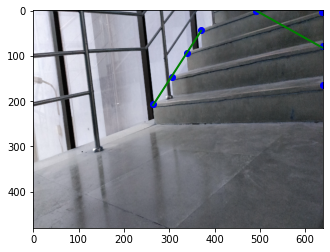

The linear model is: Y = -120.92 + 0.86881X
The linear model is: Y = -1121.3 + 9.8296X


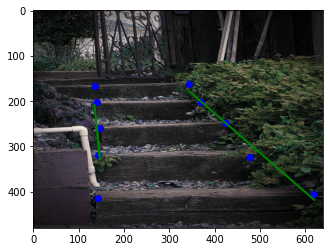

The linear model is: Y = -647.69 + 2.055X
The linear model is: Y = 674.92 + -2.4739X


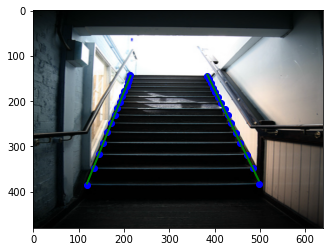

The linear model is: Y = 196.95 + 0.0X
The linear model is: Y = 496.9 + -1.2727X


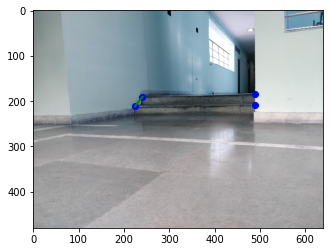

The linear model is: Y = -277.51 + 1.0169X
The linear model is: Y = -311.22 + 1.4593X


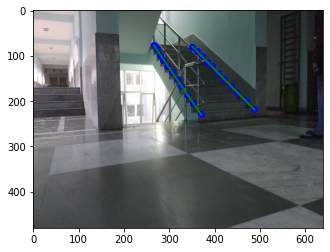

The linear model is: Y = -659.99 + 2.1282X
The linear model is: Y = 634.49 + -1.4082X


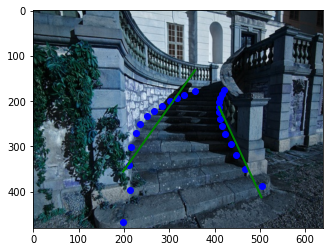

The linear model is: Y = -474.42 + 1.2685X
The linear model is: Y = 601.0 + -3.9203X


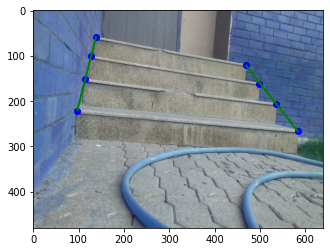

The linear model is: Y = 4223.3 + -6.2449X
The linear model is: Y = 384.86 + -217.62X


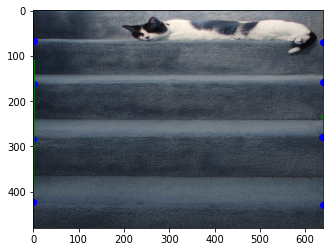

The linear model is: Y = 588.2 + -1.076X
The linear model is: Y = 32.337 + 176.39X


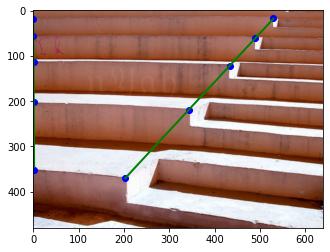

The linear model is: Y = -609.47 + 1.4522X
The linear model is: Y = 289.21 + -1.2705X


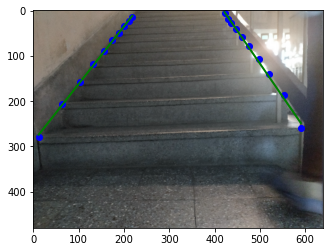

The linear model is: Y = -913.05 + 2.1333X
The linear model is: Y = 1409.5 + -6.657X


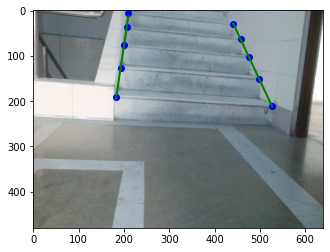

The linear model is: Y = 144.66 + -0.071429X
The linear model is: Y = 173.76 + -0.63365X


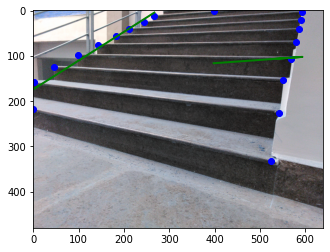

The linear model is: Y = -1019.5 + 1.8762X
The linear model is: Y = 188.29 + -1.0012X


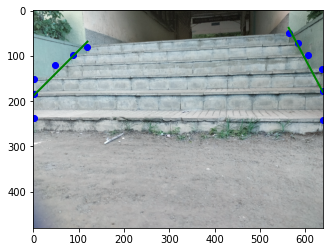

The linear model is: Y = 70.897 + 0.0345X
The linear model is: Y = 305.33 + -0.79144X


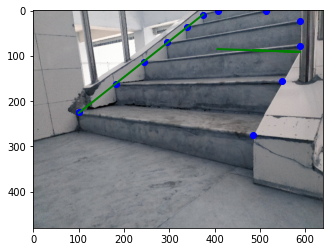

The linear model is: Y = -858.5 + 1.4926X
The linear model is: Y = 1037.1 + -2.0287X


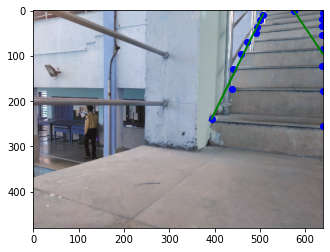

The linear model is: Y = -159.03 + 0.72765X
The linear model is: Y = -96.184 + 1.3776X


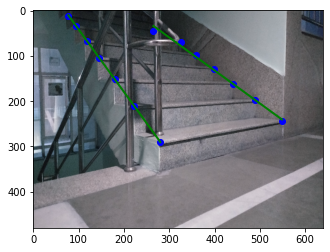

The linear model is: Y = -342.04 + 1.1783X
The linear model is: Y = 6210.9 + -33.72X


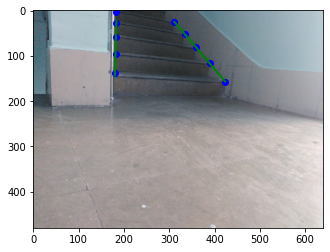

The linear model is: Y = -808.94 + 1.5769X
The linear model is: Y = 306.29 + -1.8293X


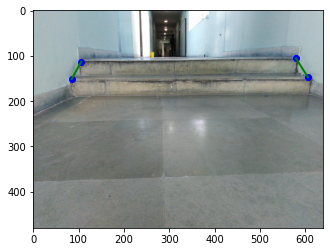

The linear model is: Y = -5.8191e+04 + 91.5X
The linear model is: Y = 493.98 + -1.6001X


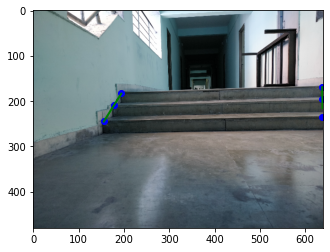

The linear model is: Y = -133.46 + 0.35248X
The linear model is: Y = 162.15 + -0.54095X


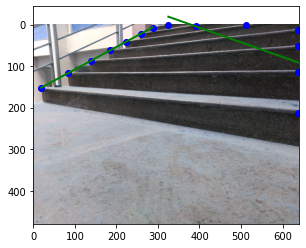

The linear model is: Y = -219.31 + 1.2125X
The linear model is: Y = 138.49 + 18.134X


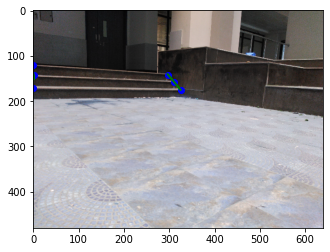

The linear model is: Y = 648.49 + -0.8661X
The linear model is: Y = 281.15 + -0.46403X


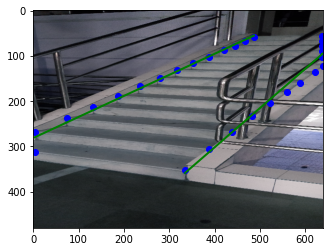

The linear model is: Y = -6061.1 + 16.104X
The linear model is: Y = 386.76 + -1.0827X


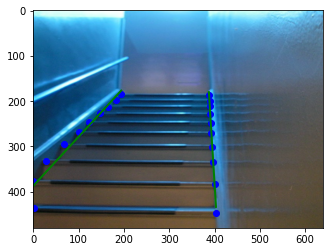

The linear model is: Y = -322.43 + 1.1591X
The linear model is: Y = 17.676 + 44.75X


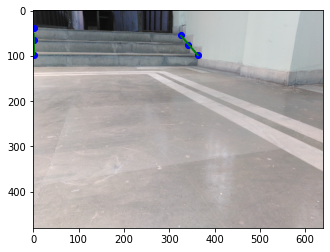

The linear model is: Y = -2579.3 + 7.4033X
The linear model is: Y = 2914.9 + -9.1819X


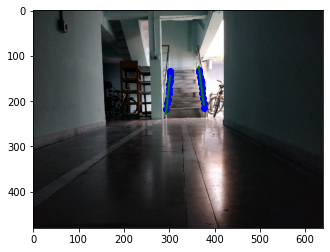

The linear model is: Y = -287.68 + 1.0231X
The linear model is: Y = -1.74e+04 + 55.091X


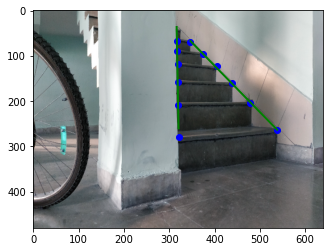

The linear model is: Y = -40.785 + 0.54336X
The linear model is: Y = 296.57 + -0.97727X


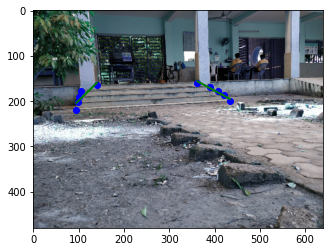

The linear model is: Y = -2964.0 + 7.1464X
The linear model is: Y = 419.99 + -1.2861X


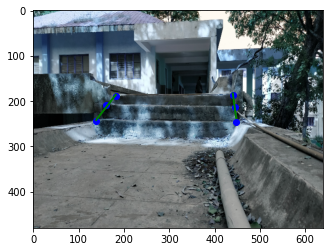

The linear model is: Y = -371.3 + 0.69299X
The linear model is: Y = 1006.8 + -2.2492X


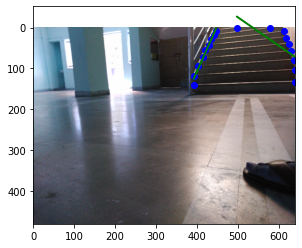

The linear model is: Y = -8.1025e+04 + 127.1X
The linear model is: Y = 115.4 + -1.0349X


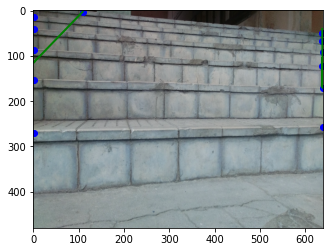

The linear model is: Y = -687.01 + 2.1844X
The linear model is: Y = -3918.2 + 15.053X


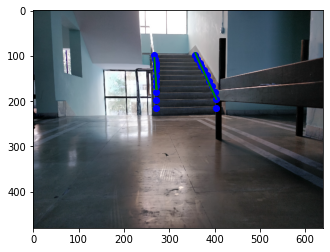

The linear model is: Y = -936.17 + 2.1799X
The linear model is: Y = 1103.2 + -2.2966X


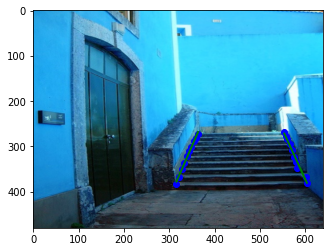

The linear model is: Y = -3.3004e+04 + 52.0X
The linear model is: Y = 8074.1 + -85.607X


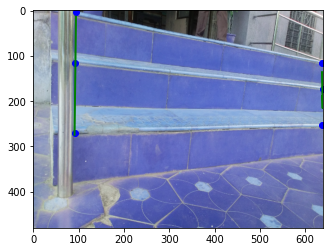

The linear model is: Y = -1541.9 + 3.8114X
The linear model is: Y = 197.39 + -0.87911X


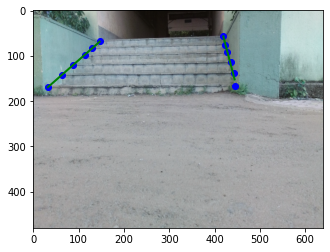

The linear model is: Y = -4780.4 + 7.7593X
The linear model is: Y = 227.19 + -1.3881X


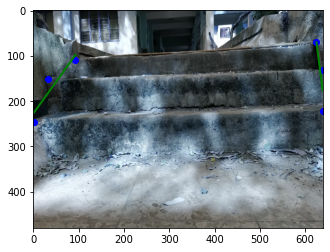

The linear model is: Y = -3094.9 + 5.1532X
The linear model is: Y = 487.96 + -2.0171X


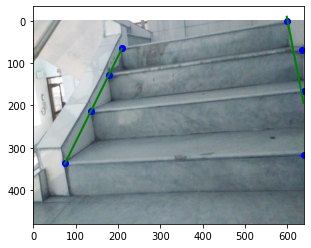

The linear model is: Y = -8982.5 + 26.225X
The linear model is: Y = 7123.7 + -22.799X


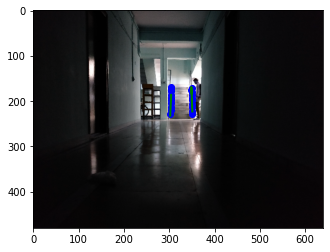

The linear model is: Y = -684.16 + 1.787X
The linear model is: Y = 220.23 + -1.0715X


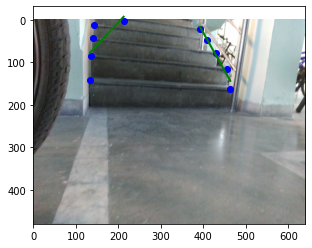

The linear model is: Y = -1733.3 + 4.9167X
The linear model is: Y = 360.77 + -1.2189X


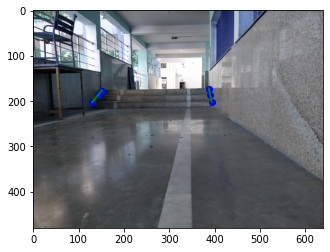

The linear model is: Y = -1.4287e+04 + 40.951X
The linear model is: Y = 3417.3 + -10.657X


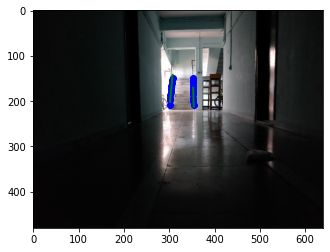

The linear model is: Y = 1268.3 + -2.202X
The linear model is: Y = 413.32 + -0.95459X


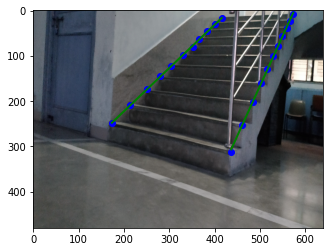

The linear model is: Y = -137.58 + 0.58742X
The linear model is: Y = 46.559 + 1.2572X


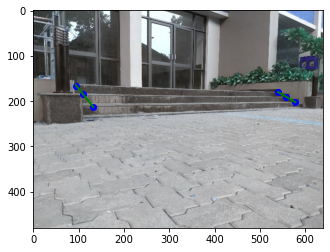

The linear model is: Y = 1002.4 + -1.759X
The linear model is: Y = 287.85 + -0.63104X


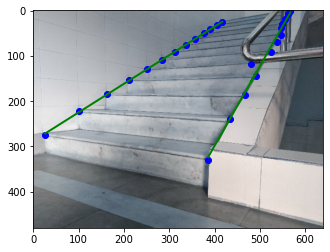

The linear model is: Y = -374.3 + 0.87542X
The linear model is: Y = -79.934 + 5.3629X


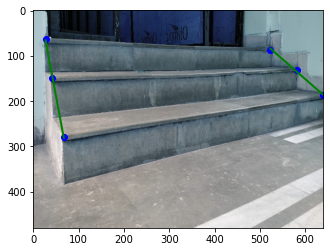

The linear model is: Y = 584.29 + -1.2213X
The linear model is: Y = 388.33 + -1.0595X


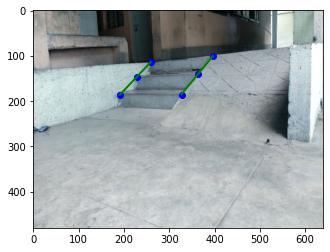

The linear model is: Y = -996.66 + 2.1579X
The linear model is: Y = 188.86 + -1.55X


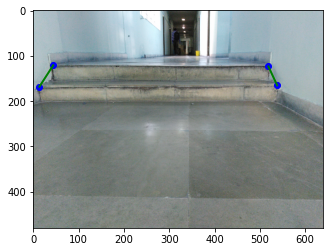

The linear model is: Y = -1521.1 + 3.4945X
The linear model is: Y = 2.481e+04 + -88.459X


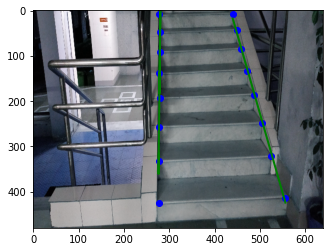

The linear model is: Y = 1.8543e+04 + -35.964X
The linear model is: Y = 404.17 + -1.2859X


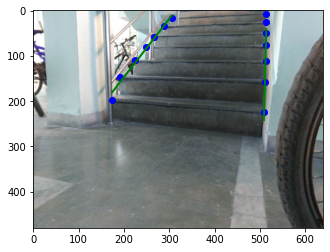

The linear model is: Y = -1128.1 + 3.1408X
The linear model is: Y = 443.66 + -0.76793X


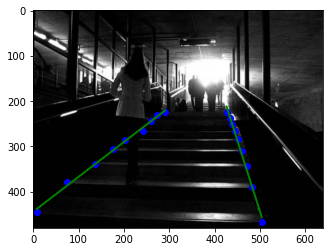

The linear model is: Y = 8337.8 + -14.418X
The linear model is: Y = 302.19 + -0.84253X


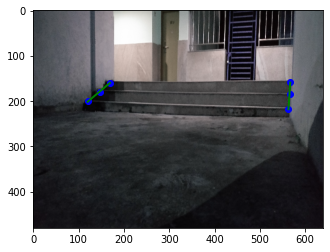

The linear model is: Y = -449.42 + 1.5572X
The linear model is: Y = -812.53 + 3.4373X


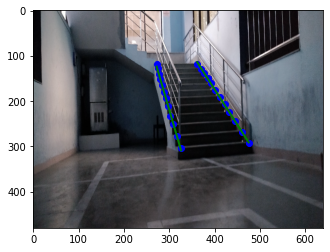

The linear model is: Y = -1245.8 + 3.867X
The linear model is: Y = 870.49 + -2.5767X


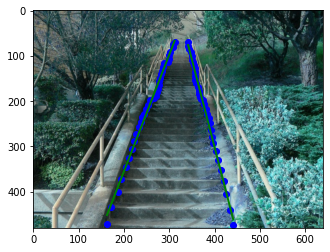

The linear model is: Y = -586.35 + 1.3375X
The linear model is: Y = 314.2 + -1.2924X


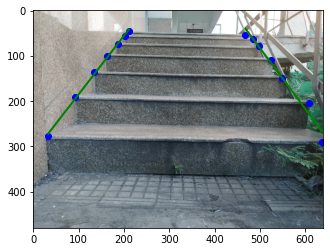

The linear model is: Y = -2433.0 + 5.703X
The linear model is: Y = 442.54 + -2.0664X


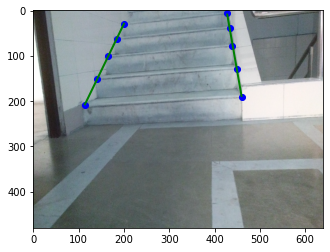

The linear model is: Y = -379.01 + 0.84652X
The linear model is: Y = 507.39 + -2.2048X


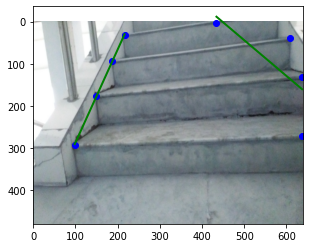

The linear model is: Y = -635.78 + 2.0276X
The linear model is: Y = -5934.5 + 19.37X


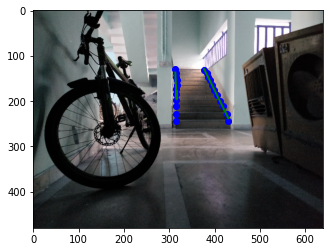

The linear model is: Y = -187.61 + 0.96125X
The linear model is: Y = 417.22 + -0.64945X


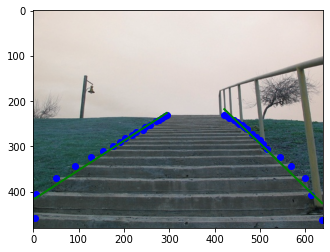

The linear model is: Y = -217.15 + 0.804X
The linear model is: Y = -330.63 + 3.477X


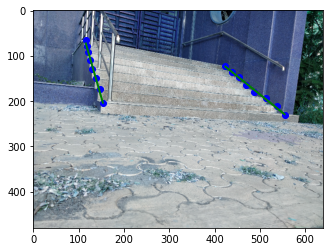

The linear model is: Y = -225.04 + 0.67405X
The linear model is: Y = -2792.0 + 23.25X


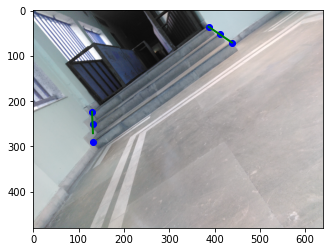

The linear model is: Y = -705.9 + 1.6237X
The linear model is: Y = 1335.9 + -4.342X


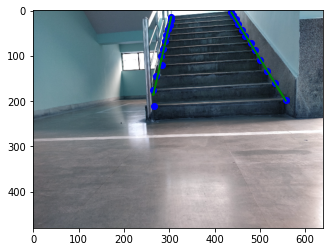

The linear model is: Y = 1145.4 + -2.9536X
The linear model is: Y = 459.56 + -1.6183X


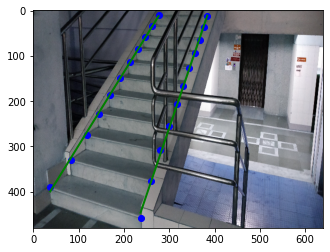

The linear model is: Y = -310.15 + 1.0416X
The linear model is: Y = -564.09 + 4.5473X


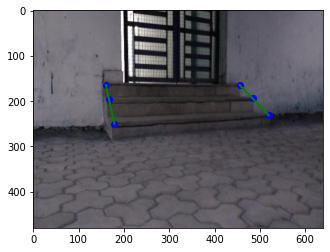

The linear model is: Y = -8048.0 + 15.022X
The linear model is: Y = 320.4 + -0.80573X


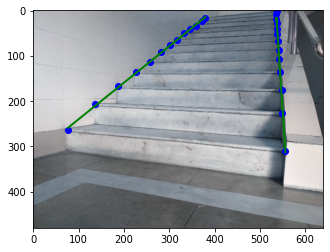

The linear model is: Y = -310.33 + 1.2199X
The linear model is: Y = -1337.3 + 5.8654X


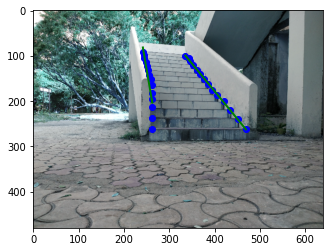

The linear model is: Y = -2135.6 + 5.368X
The linear model is: Y = 407.13 + -1.1702X


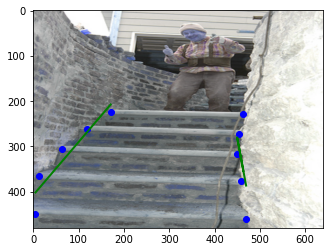

The linear model is: Y = -18.004 + 0.46853X
The linear model is: Y = 92.255 + 0.87811X


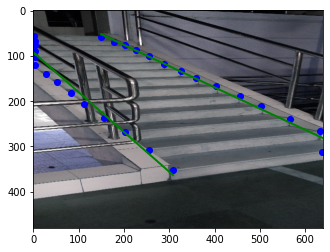

The linear model is: Y = 5.7967e+04 + -91.0X
The linear model is: Y = 634.88 + -0.86792X


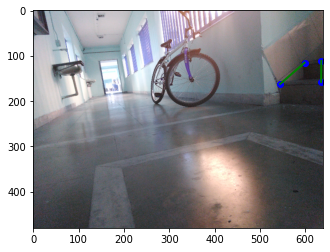

The linear model is: Y = 4.2171e+04 + -65.846X
The linear model is: Y = 674.51 + -1.2698X


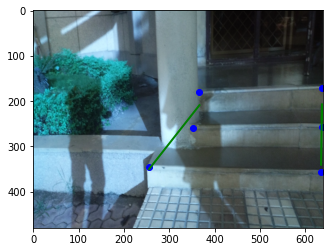

The linear model is: Y = -2513.8 + 4.3955X
The linear model is: Y = 295.85 + -0.90123X


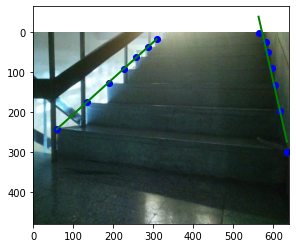

The linear model is: Y = -290.6 + 1.005X
The linear model is: Y = 1763.0 + -12.963X


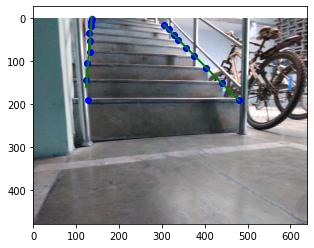

The linear model is: Y = -74.097 + 0.55977X
The linear model is: Y = -2771.6 + 13.131X


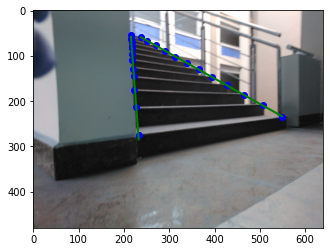

The linear model is: Y = -176.22 + 1.3878X
The linear model is: Y = 177.16 + 0.0X


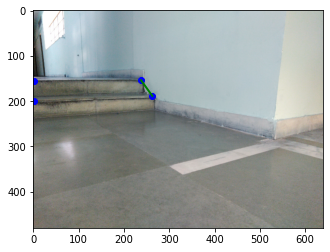

The linear model is: Y = -325.18 + 1.1139X
The linear model is: Y = 4541.6 + -17.109X


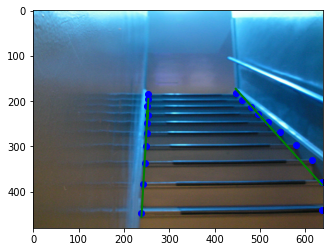

The linear model is: Y = -23.746 + 0.71716X
The linear model is: Y = 886.71 + -3.1579X


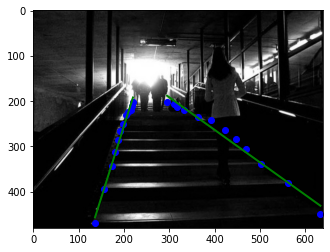

The linear model is: Y = -1269.4 + 4.2565X
The linear model is: Y = 1195.1 + -5.4789X


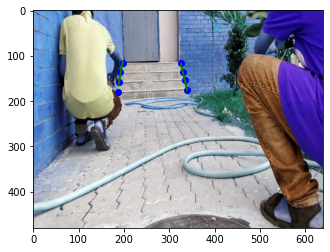

The linear model is: Y = -526.54 + 1.1904X
The linear model is: Y = 267.42 + -1.3134X


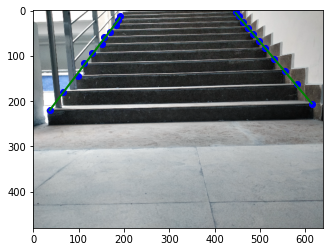

The linear model is: Y = -9014.2 + 14.514X
The linear model is: Y = 224.57 + -2.5341X


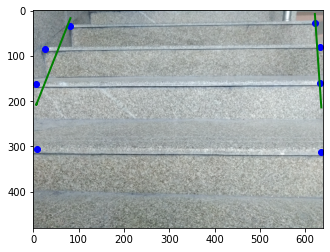

The linear model is: Y = -3213.2 + 7.4383X
The linear model is: Y = 914.51 + -3.0914X


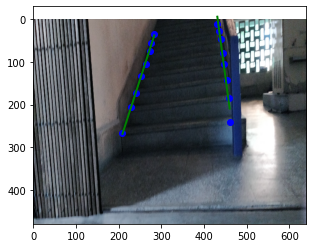

The linear model is: Y = -139.74 + 0.65234X
The linear model is: Y = -891.9 + 6.1639X


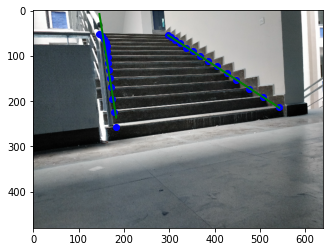

The linear model is: Y = -153.78 + 0.82962X
The linear model is: Y = -759.98 + 4.6116X


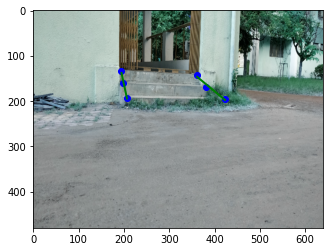

The linear model is: Y = -872.51 + 2.5859X
The linear model is: Y = 135.21 + 0.96726X


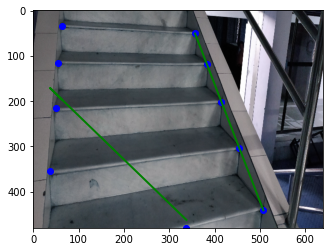

The linear model is: Y = 3061.4 + -8.1689X
The linear model is: Y = 1061.7 + -2.6654X


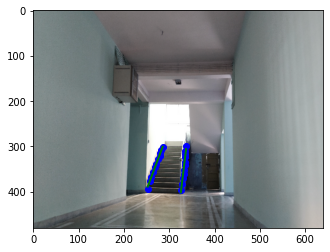

The linear model is: Y = -389.28 + 1.0891X
The linear model is: Y = 1281.4 + -6.6069X


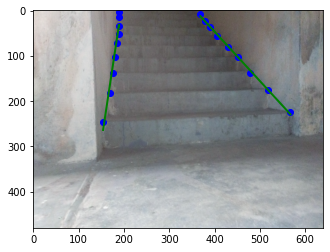

The linear model is: Y = 1184.8 + -1.6179X
The linear model is: Y = 260.02 + -0.80171X


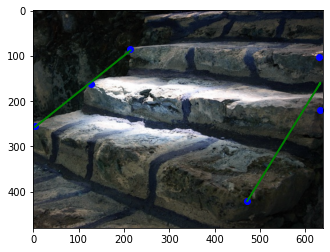

The linear model is: Y = -364.37 + 0.7782X
The linear model is: Y = 148.35 + -0.92882X


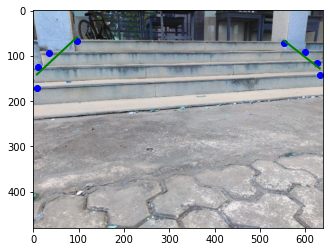

The linear model is: Y = -262.38 + 2.0636X
The linear model is: Y = 109.59 + -3.3131X


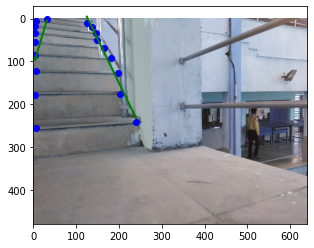

The linear model is: Y = -181.96 + 0.61001X
The linear model is: Y = 158.47 + -0.84841X


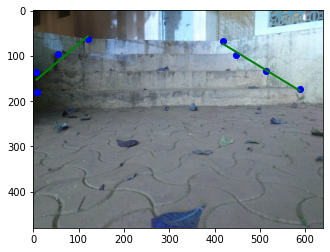

The linear model is: Y = -55.511 + 0.5271X
The linear model is: Y = -1295.1 + 8.1445X


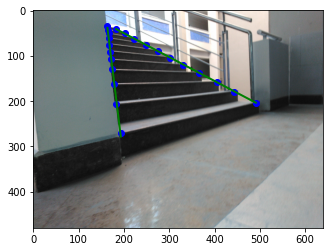

The linear model is: Y = -410.72 + 1.1401X
The linear model is: Y = 404.63 + -2.1377X


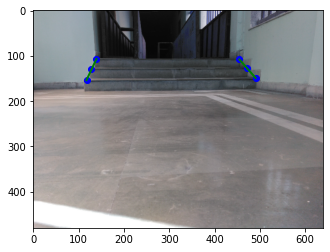

The linear model is: Y = 1237.1 + -2.2404X
The linear model is: Y = 269.27 + -0.73425X


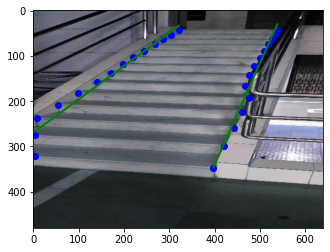

The linear model is: Y = 3728.8 + -5.7143X
The linear model is: Y = 437.36 + -0.943X


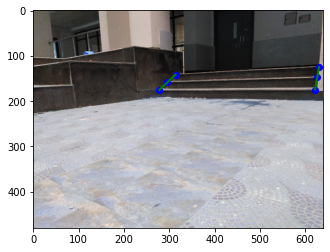

The linear model is: Y = -234.11 + 0.72816X
The linear model is: Y = 34.613 + 9.5394X


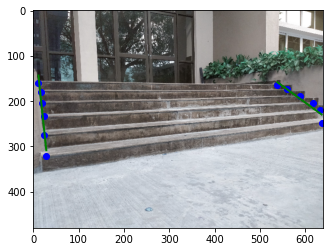

The linear model is: Y = -587.78 + 1.8419X
The linear model is: Y = -1659.1 + 8.0645X


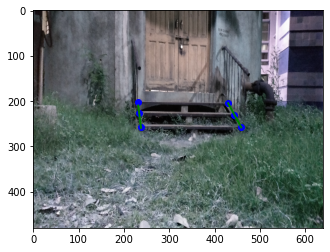

The linear model is: Y = 2353.4 + -4.5523X
The linear model is: Y = 348.63 + -0.98673X


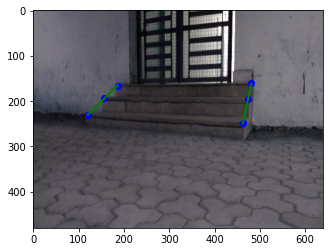

The linear model is: Y = -358.01 + 1.1424X
The linear model is: Y = 565.61 + -1.7205X


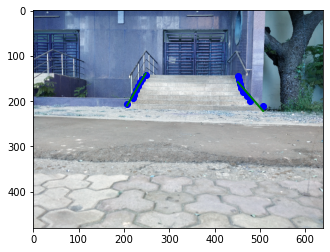

The linear model is: Y = -2099.3 + 5.5079X
The linear model is: Y = 409.23 + -1.3618X


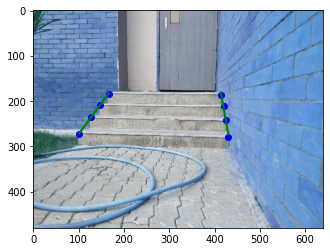

The linear model is: Y = -655.77 + 1.9344X
The linear model is: Y = -2036.4 + 9.694X


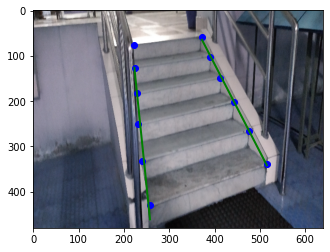

The linear model is: Y = -1.0494e+04 + 18.883X
The linear model is: Y = 720.45 + -1.9994X


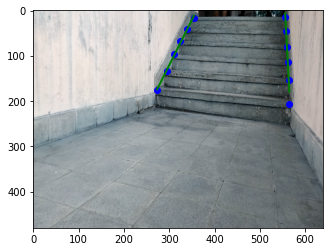

The linear model is: Y = -385.77 + 1.5377X
The linear model is: Y = 215.28 + -1.1512X


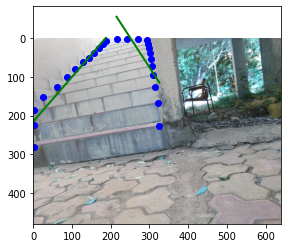

The linear model is: Y = -494.16 + 1.1416X
The linear model is: Y = 2232.1 + -6.2274X


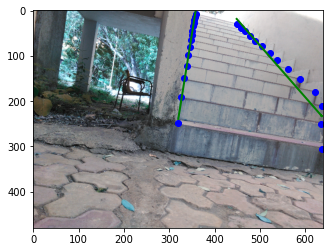

The linear model is: Y = -1237.5 + 3.0428X
The linear model is: Y = 270.57 + -56.5X


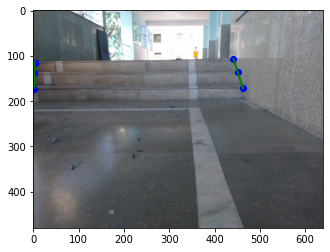

The linear model is: Y = -455.04 + 1.366X
The linear model is: Y = 652.88 + -3.1702X


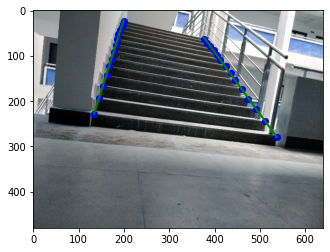

The linear model is: Y = -4622.6 + 9.006X
The linear model is: Y = 323.93 + -0.80731X


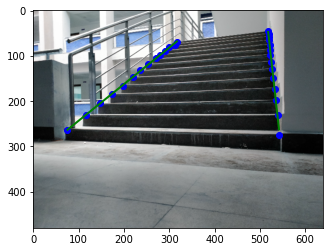

The linear model is: Y = -251.09 + 0.87462X
The linear model is: Y = -336.52 + 2.2558X


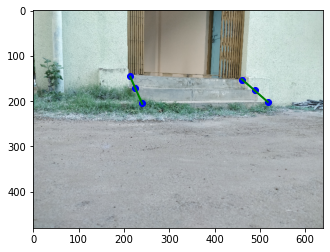

The linear model is: Y = -516.35 + 1.1619X
The linear model is: Y = 498.6 + -2.2958X


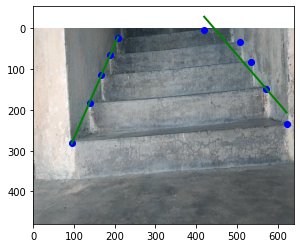

The linear model is: Y = 5864.8 + -14.473X
The linear model is: Y = 545.66 + -1.5694X


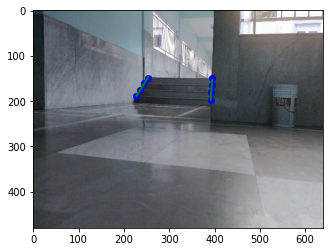

The linear model is: Y = -2267.3 + 5.9023X
The linear model is: Y = 916.1 + -2.17X


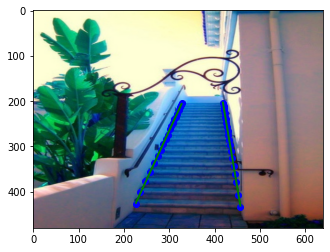

The linear model is: Y = -184.17 + 0.54369X
The linear model is: Y = 94.912 + -0.4513X


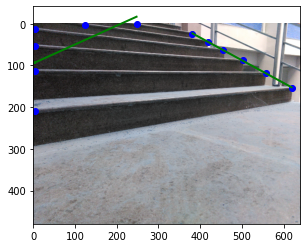

The linear model is: Y = 2371.6 + -3.7674X
The linear model is: Y = 381.08 + -0.68174X


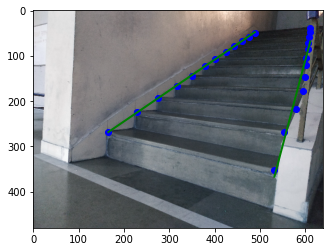

The linear model is: Y = -585.68 + 2.0742X
The linear model is: Y = 473.47 + -2.3608X


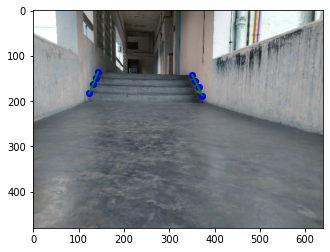

The linear model is: Y = -309.27 + 1.1773X
The linear model is: Y = 129.37 + 0.51961X


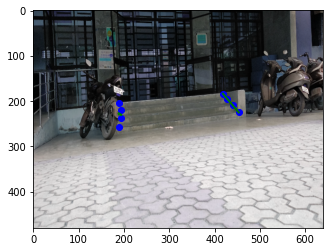

The linear model is: Y = -1949.8 + 3.5266X
The linear model is: Y = 268.84 + -1.3585X


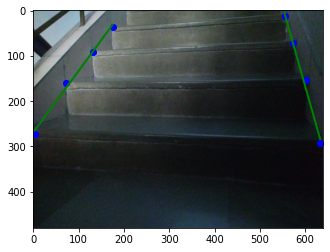

The linear model is: Y = -2462.5 + 4.8225X
The linear model is: Y = 283.61 + -0.51674X


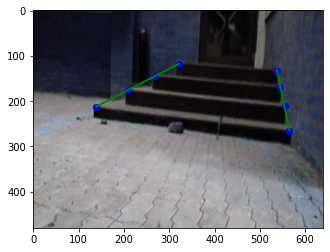

The linear model is: Y = -163.18 + 1.2162X
The linear model is: Y = 171.24 + 0.0X


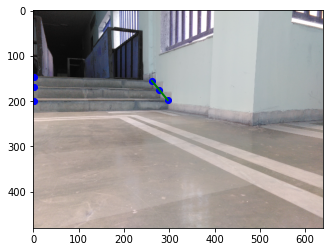

The linear model is: Y = -495.44 + 1.2686X
The linear model is: Y = -529.21 + 210.18X


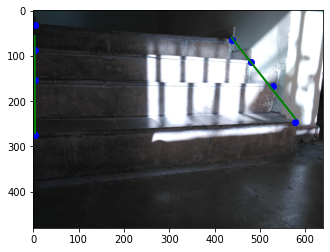

The linear model is: Y = -9.2199e+04 + 145.0X
The linear model is: Y = 625.69 + -3.1611X


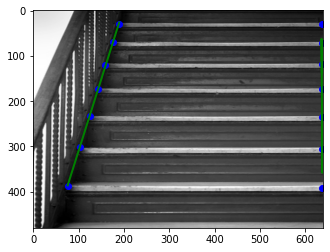

The linear model is: Y = 2.2752e+04 + -38.441X
The linear model is: Y = 252.02 + -0.39138X


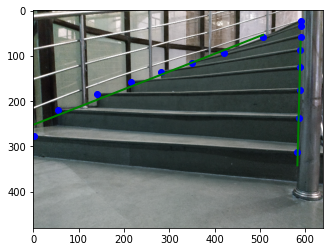

The linear model is: Y = -129.79 + 0.75395X
The linear model is: Y = -3315.5 + 30.571X


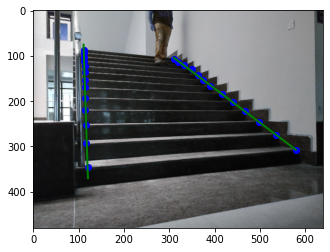

The linear model is: Y = -390.05 + 1.1928X
The linear model is: Y = -1238.7 + 4.7942X


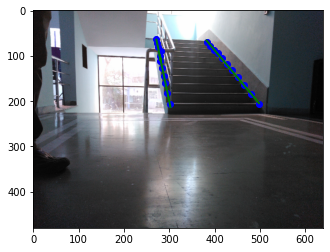

The linear model is: Y = -1863.2 + 3.9595X
The linear model is: Y = 517.0 + -1.2848X


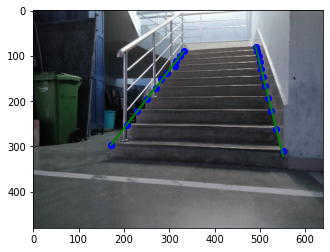

The linear model is: Y = -562.96 + 1.695X
The linear model is: Y = 675.33 + -2.2924X


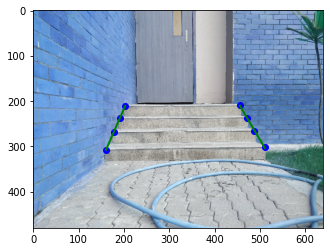

The linear model is: Y = -1503.0 + 2.8805X
The linear model is: Y = 375.36 + -0.94052X


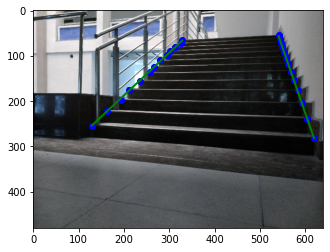

The linear model is: Y = 2925.1 + -5.9869X
The linear model is: Y = 446.21 + -0.79568X


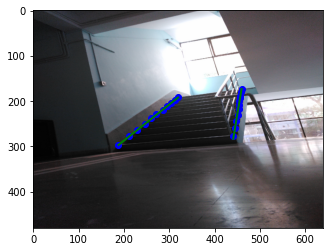

The linear model is: Y = -2.215e+04 + 44.463X
The linear model is: Y = 277.94 + -0.78161X


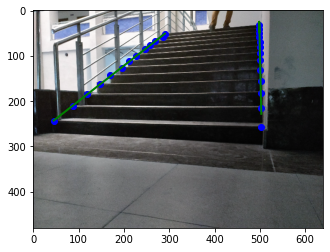

The linear model is: Y = -716.73 + 2.3889X
The linear model is: Y = 4259.1 + -18.0X


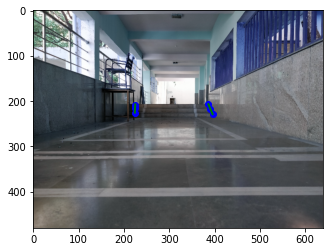

The linear model is: Y = -144.6 + 0.62701X
The linear model is: Y = 275.93 + -2.0216X


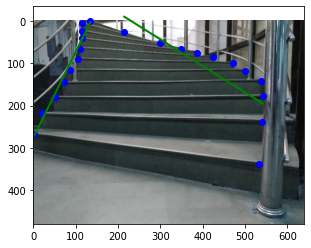

The linear model is: Y = -739.62 + 1.6583X
The linear model is: Y = 382.3 + -136.0X


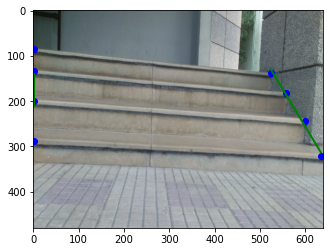

The linear model is: Y = -109.79 + 0.60635X
The linear model is: Y = -2929.8 + 18.667X


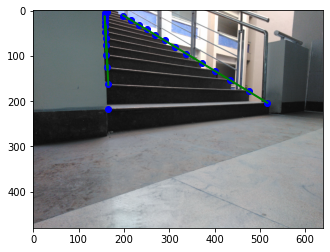

The linear model is: Y = -1589.9 + 4.7659X
The linear model is: Y = 949.91 + -4.0432X


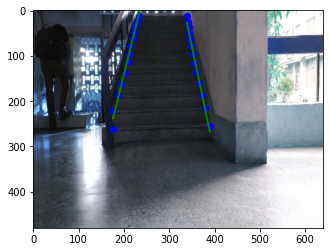

The linear model is: Y = -3.5851e+04 + 56.5X
The linear model is: Y = 267.55 + -0.28485X


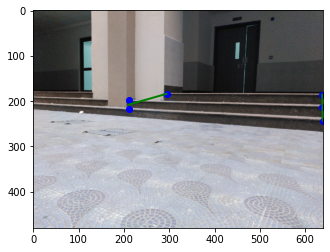

The linear model is: Y = 6.8377e+04 + -107.15X
The linear model is: Y = 179.41 + -1.5481X


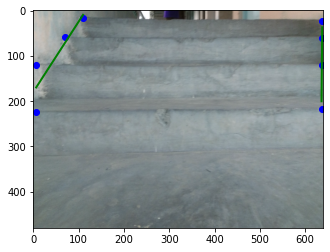

The linear model is: Y = -3477.1 + 11.798X
The linear model is: Y = 915.95 + -4.1214X


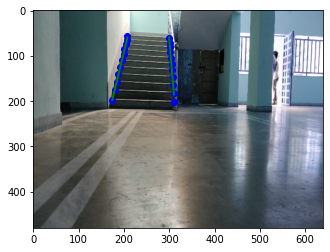

The linear model is: Y = -467.61 + 1.2857X
The linear model is: Y = -327.12 + 3.2308X


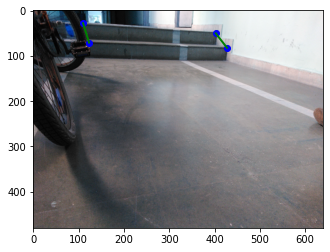

The linear model is: Y = -2085.8 + 4.6921X
The linear model is: Y = 586.87 + -1.9017X


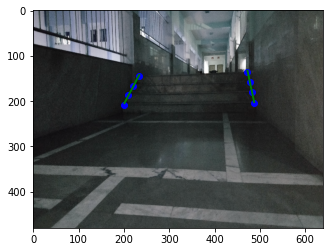

The linear model is: Y = 4.5361e+04 + -71.023X
The linear model is: Y = 556.47 + -1.0645X


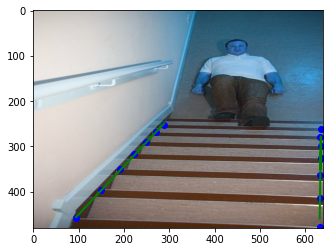

The linear model is: Y = -308.82 + 1.0881X
The linear model is: Y = 2589.2 + -13.881X


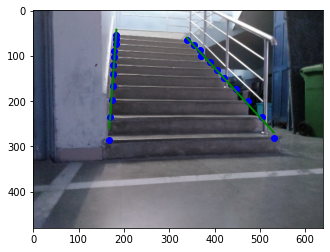

The linear model is: Y = -7.9689e+04 + 125.21X
The linear model is: Y = 925.07 + -1.9076X


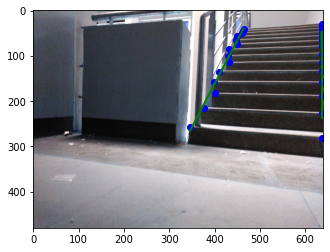

The linear model is: Y = -6179.8 + 16.071X
The linear model is: Y = 419.09 + -1.327X


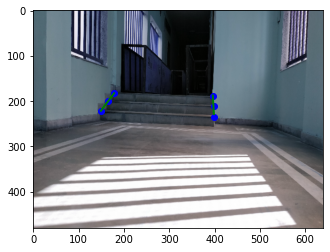

The linear model is: Y = -4161.4 + 8.7328X
The linear model is: Y = 1185.8 + -2.6172X


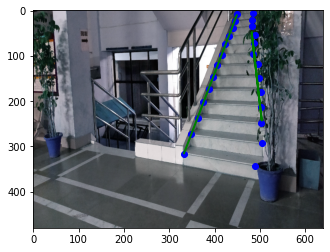

The linear model is: Y = -2134.2 + 7.2481X
The linear model is: Y = 2641.4 + -12.673X


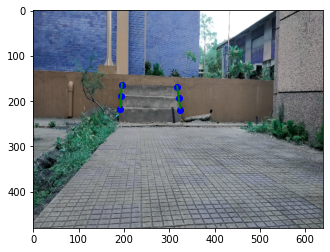

The linear model is: Y = -659.37 + 1.5434X
The linear model is: Y = 333.31 + -2.5156X


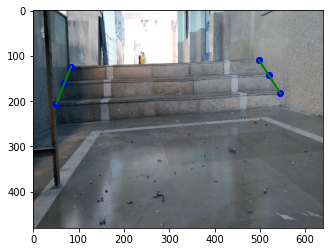

The linear model is: Y = -987.36 + 2.0513X
The linear model is: Y = 188.07 + -1.3607X


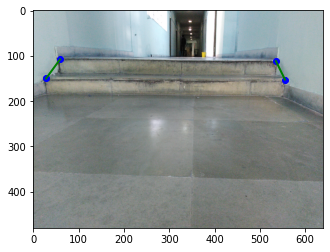

The linear model is: Y = -2841.7 + 5.3225X
The linear model is: Y = 258.26 + -1.0061X


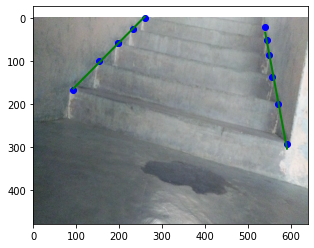

The linear model is: Y = 6.142e+04 + -96.192X
The linear model is: Y = 328.89 + -0.40279X


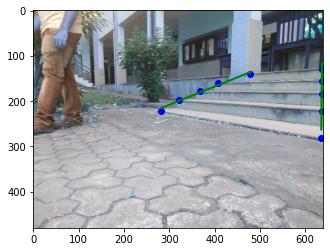

The linear model is: Y = -1536.6 + 2.5443X
The linear model is: Y = 338.87 + -0.59192X


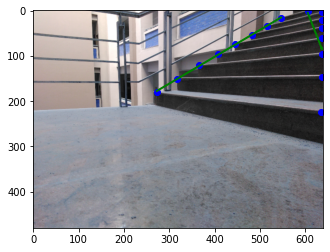

The linear model is: Y = -127.43 + 0.67312X
The linear model is: Y = 6.887 + 0.77334X


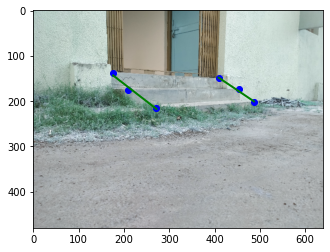

The linear model is: Y = 37.932 + 0.51163X
The linear model is: Y = -1595.7 + 17.5X


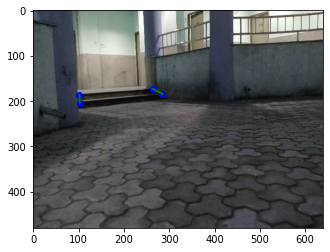

The linear model is: Y = -7218.7 + 19.615X
The linear model is: Y = 714.16 + -2.9239X


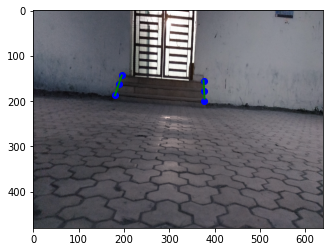

The linear model is: Y = -155.05 + 0.64295X
The linear model is: Y = 656.64 + -166.5X


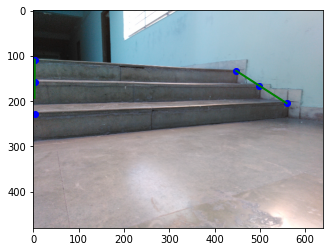

The linear model is: Y = -114.37 + 0.79181X
The linear model is: Y = -15.923 + 1.8344X


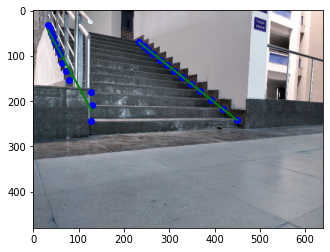

The linear model is: Y = -391.24 + 1.1378X
The linear model is: Y = 1450.2 + -4.5101X


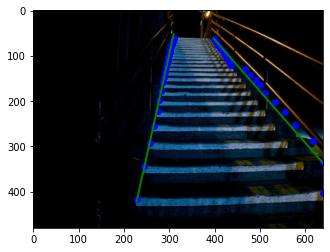

The linear model is: Y = -432.48 + 0.99952X
The linear model is: Y = 351.18 + -2.8519X


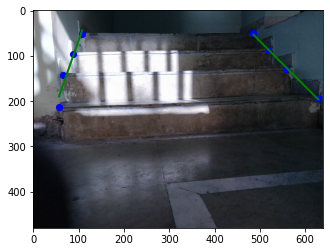

The linear model is: Y = -642.24 + 1.459X
The linear model is: Y = 558.12 + -2.0739X


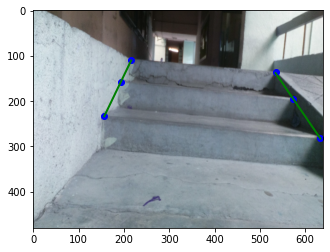

The linear model is: Y = -676.23 + 3.3383X
The linear model is: Y = -1389.6 + 8.0072X


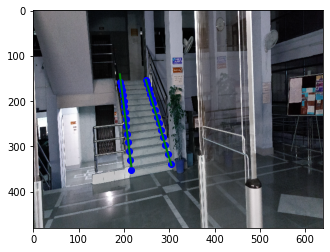

The linear model is: Y = -6568.7 + 20.932X
The linear model is: Y = 1066.6 + -3.6929X


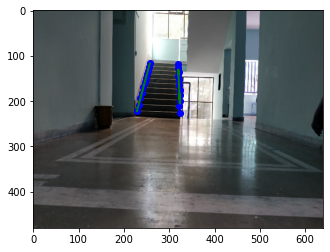

The linear model is: Y = 74.411 + 0.92X
The linear model is: Y = 99.353 + 47.5X


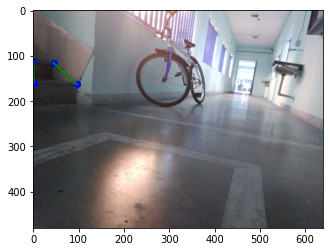

The linear model is: Y = -671.52 + 1.6512X
The linear model is: Y = 282.43 + -1.3566X


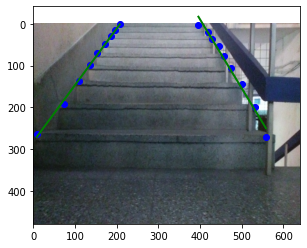

The linear model is: Y = 178.43 + 0.0X
The linear model is: Y = 781.31 + -1.5778X


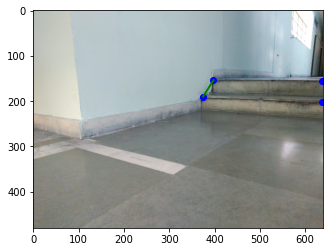

The linear model is: Y = -2206.6 + 5.3404X
The linear model is: Y = 988.32 + -4.2755X


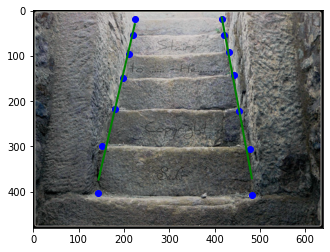

The linear model is: Y = -980.38 + 2.8867X
The linear model is: Y = 299.46 + -1.1374X


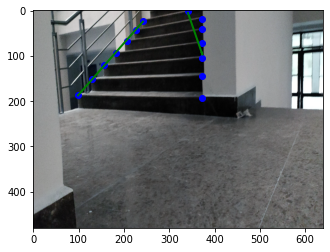

The linear model is: Y = -259.31 + 2.3337X
The linear model is: Y = 362.97 + -94.0X


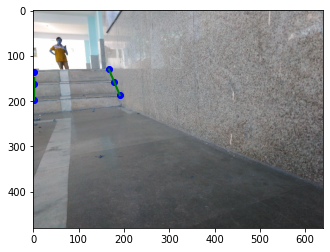

The linear model is: Y = -229.81 + 1.0233X
The linear model is: Y = -3346.0 + 19.405X


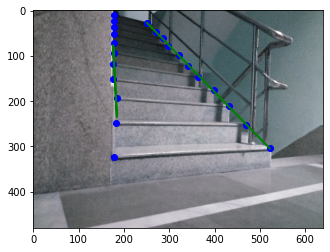

The linear model is: Y = -662.35 + 2.2778X
The linear model is: Y = 806.52 + -3.2936X


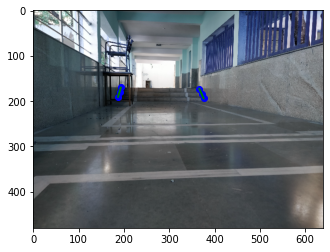

The linear model is: Y = -908.28 + 2.0217X
The linear model is: Y = 302.65 + -1.057X


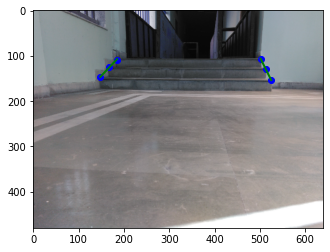

The linear model is: Y = -663.1 + 1.9954X
The linear model is: Y = 1167.0 + -4.8718X


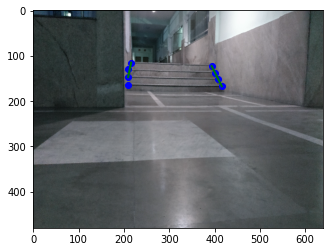

The linear model is: Y = -251.46 + 0.83288X
The linear model is: Y = 296.6 + -1.2119X


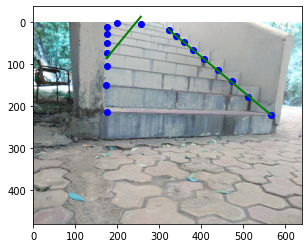

The linear model is: Y = -298.44 + 1.9204X
The linear model is: Y = -68.158 + 96.26X


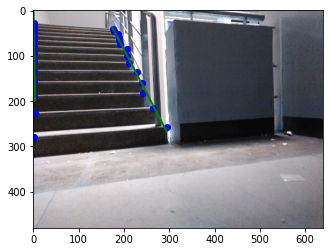

The linear model is: Y = -264.23 + 0.78705X
The linear model is: Y = 301.44 + -40.5X


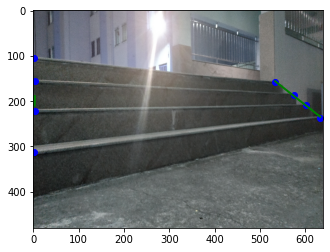

The linear model is: Y = 2953.6 + -7.2516X
The linear model is: Y = 417.02 + -1.3235X


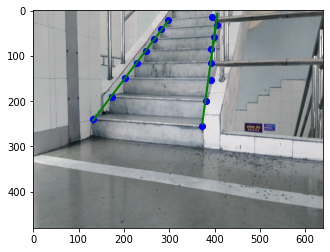

The linear model is: Y = -113.99 + 0.49441X
The linear model is: Y = 661.78 + -6.096X


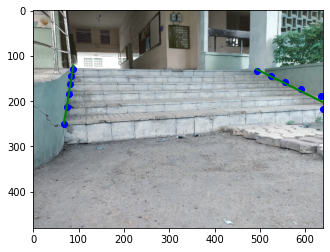

The linear model is: Y = 70.167 + 0.21715X
The linear model is: Y = 254.1 + -23.769X


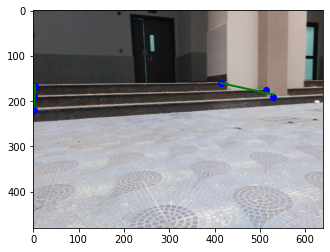

The linear model is: Y = 2392.6 + -8.4515X
The linear model is: Y = 634.33 + -2.6591X


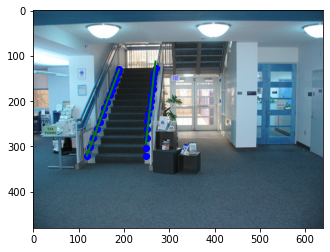

The linear model is: Y = 295.38 + -0.35897X
The linear model is: Y = 676.76 + -2.0966X


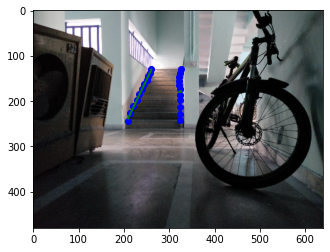

The linear model is: Y = 267.32 + 0.083213X
The linear model is: Y = 382.28 + -0.62792X


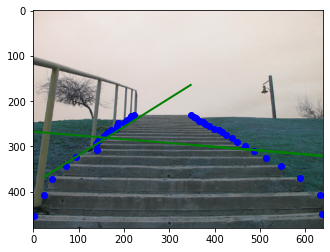

The linear model is: Y = -643.45 + 5.3095X
The linear model is: Y = 110.26 + -5.3328X


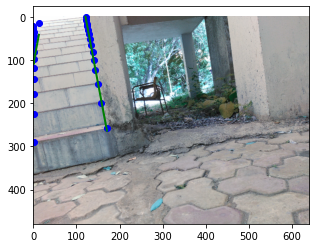

The linear model is: Y = -48.487 + 0.40982X
The linear model is: Y = 325.49 + -0.70861X


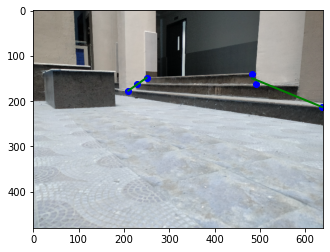

The linear model is: Y = -364.29 + 1.7333X
The linear model is: Y = 172.59 + 0.0X


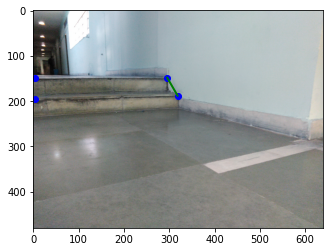

The linear model is: Y = -65.062 + 0.24516X
The linear model is: Y = 520.14 + -145.55X


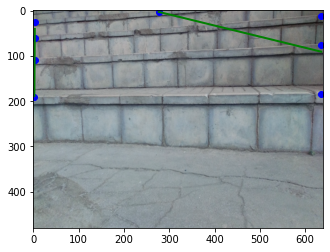

The linear model is: Y = -969.62 + 3.1337X
The linear model is: Y = 24.332 + 68.5X


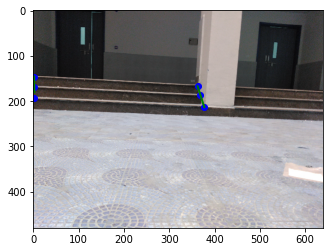

The linear model is: Y = 4.45e+04 + -69.5X
The linear model is: Y = 476.77 + -2.1686X


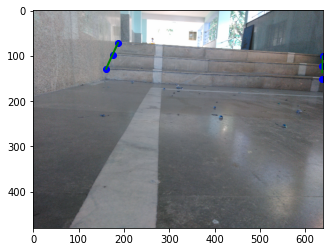

The linear model is: Y = -224.58 + 0.98348X
The linear model is: Y = -349.16 + 2.3111X


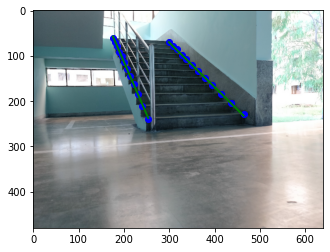

The linear model is: Y = 813.68 + -1.4324X
The linear model is: Y = 299.36 + -0.80421X


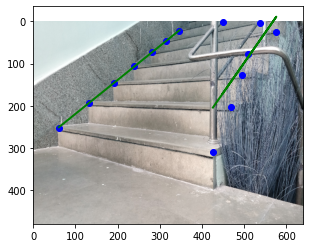

The linear model is: Y = -451.59 + 1.679X
The linear model is: Y = 336.36 + -0.42469X


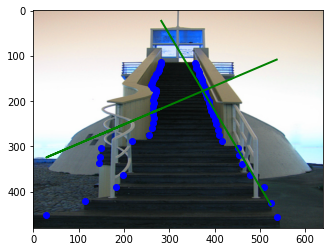

The linear model is: Y = -236.92 + 0.98018X
The linear model is: Y = 342.92 + -2.8388X


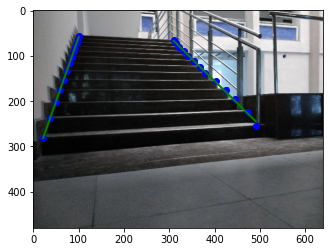

The linear model is: Y = -1131.6 + 2.0131X
The linear model is: Y = 2585.9 + -5.6093X


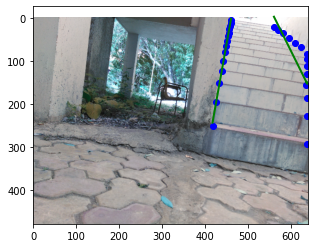

The linear model is: Y = -429.6 + 0.8823X
The linear model is: Y = 213.18 + -0.59441X


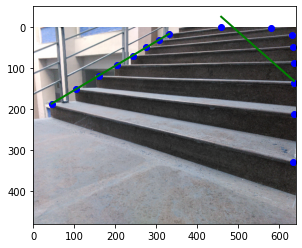

The linear model is: Y = -232.62 + 0.6142X
The linear model is: Y = 75.084 + 1.9138X


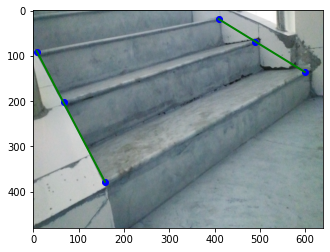

The linear model is: Y = -204.0 + 0.71503X
The linear model is: Y = 207.6 + -1.8867X


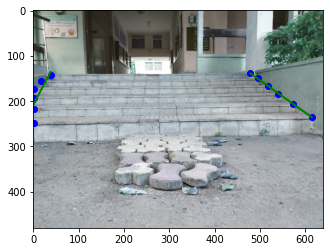

The linear model is: Y = -279.71 + 1.2586X
The linear model is: Y = 638.99 + -1.7545X


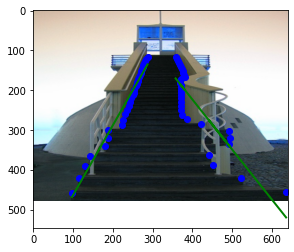

The linear model is: Y = 610.11 + -0.94531X
The linear model is: Y = 287.48 + -0.52921X


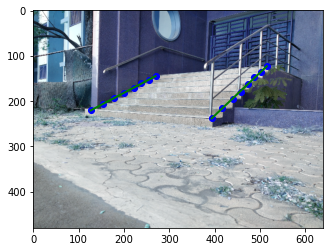

The linear model is: Y = 1488.9 + -3.7893X
The linear model is: Y = 748.86 + -2.184X


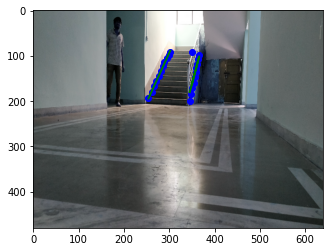

The linear model is: Y = 3726.0 + -9.1524X
The linear model is: Y = 693.87 + -1.8654X


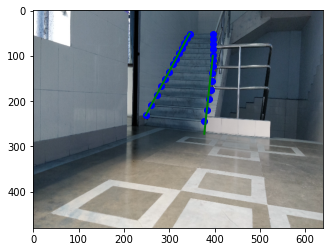

The linear model is: Y = -63.672 + 0.52377X
The linear model is: Y = -0.97843 + 44.75X


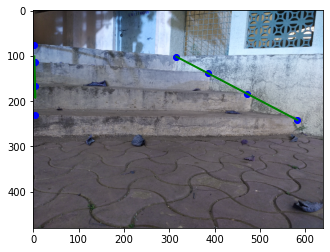

The linear model is: Y = -204.26 + 1.1558X
The linear model is: Y = -9187.2 + 31.464X


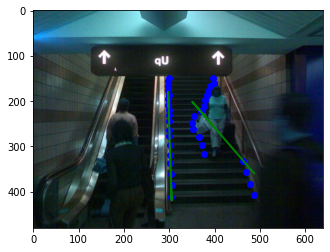

The linear model is: Y = -552.69 + 1.3775X
The linear model is: Y = 348.9 + -1.2275X


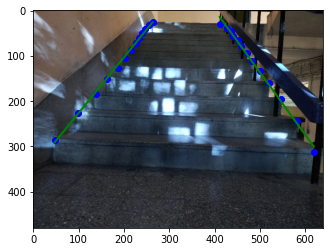

The linear model is: Y = -1241.8 + 3.6097X
The linear model is: Y = 493.83 + -2.8695X


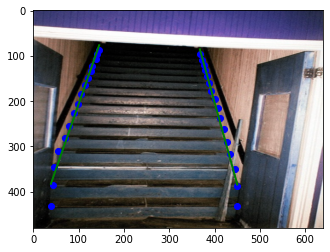

The linear model is: Y = -1355.9 + 3.5714X
The linear model is: Y = 1761.1 + -5.0X


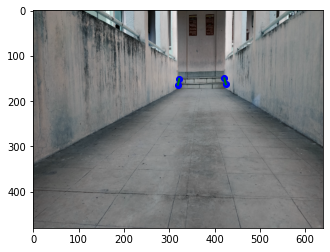

The linear model is: Y = -637.7 + 1.6177X
The linear model is: Y = 200.96 + -3.1073X


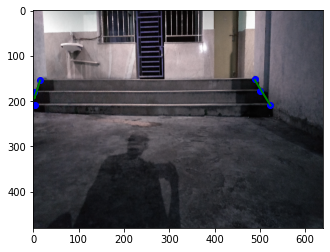

The linear model is: Y = 1.7855e+04 + -35.084X
The linear model is: Y = 298.5 + -0.091449X


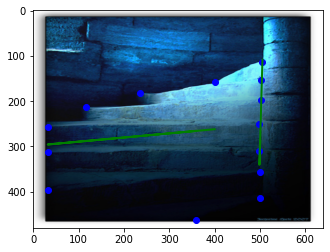

The linear model is: Y = -165.5 + 0.71377X
The linear model is: Y = -116.17 + 1.5279X


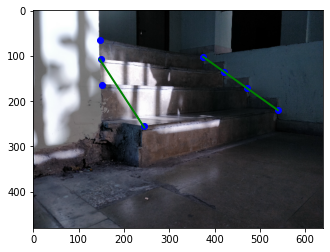

The linear model is: Y = 872.06 + -1.5582X
The linear model is: Y = 293.41 + -0.72135X


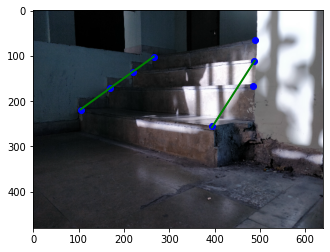

The linear model is: Y = -1218.8 + 2.0903X
The linear model is: Y = 613.96 + -1.1777X


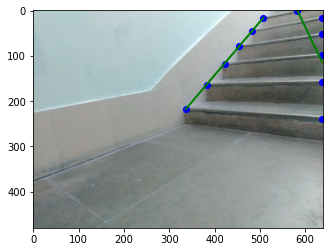

The linear model is: Y = -2915.2 + 7.8664X
The linear model is: Y = 823.58 + -2.667X


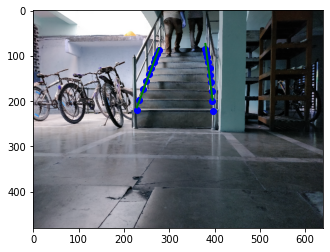

The linear model is: Y = 5734.8 + -8.8333X
The linear model is: Y = 429.83 + -0.67086X


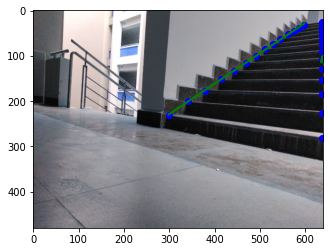

The linear model is: Y = -4.0788e+04 + 64.206X
The linear model is: Y = 315.11 + -0.8334X


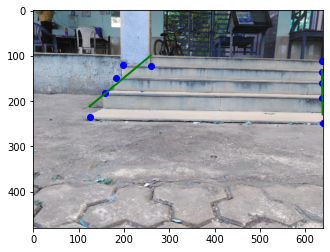

The linear model is: Y = -686.23 + 2.3682X
The linear model is: Y = -2737.7 + 10.0X


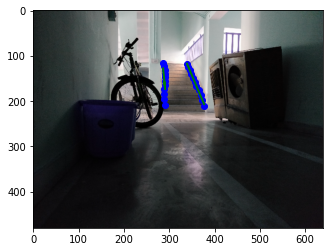

The linear model is: Y = 36.045 + 0.39004X
The linear model is: Y = 375.8 + -59.25X


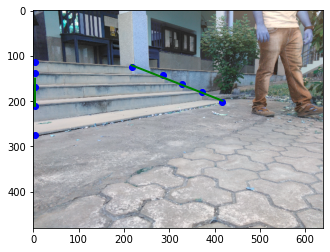

The linear model is: Y = -2135.1 + 5.3412X
The linear model is: Y = -9578.4 + 29.896X


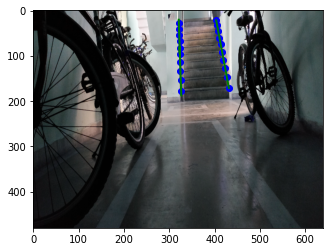

The linear model is: Y = -967.6 + 2.8118X
The linear model is: Y = 850.46 + -2.5165X


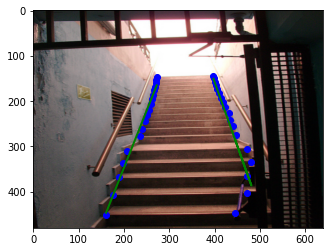

The linear model is: Y = -120.88 + 0.64214X
The linear model is: Y = -143.76 + 1.881X


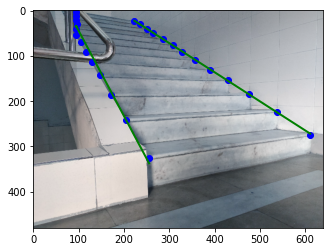

The linear model is: Y = -250.17 + 1.2565X
The linear model is: Y = 396.85 + -2.2403X


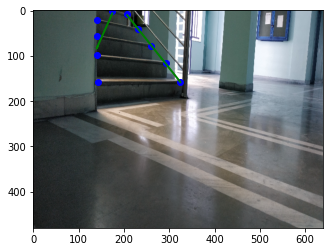

The linear model is: Y = -3905.6 + 8.5116X
The linear model is: Y = 270.68 + -1.3202X


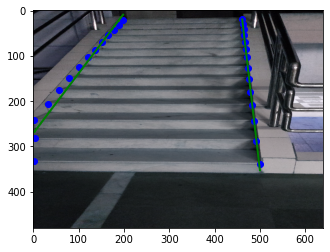

The linear model is: Y = -120.42 + 2.3166X
The linear model is: Y = 24.236 + 99.5X


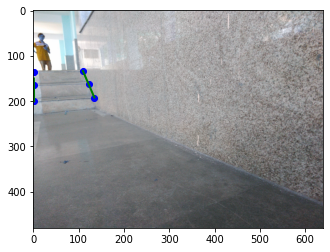

The linear model is: Y = -286.12 + 0.81412X
The linear model is: Y = 814.61 + -288.67X


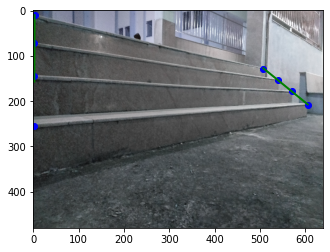

The linear model is: Y = -28.985 + 0.68824X
The linear model is: Y = 33.436 + 2.0029X


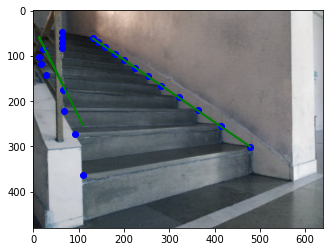

The linear model is: Y = -8993.5 + 14.769X
The linear model is: Y = 1946.0 + -5.7393X


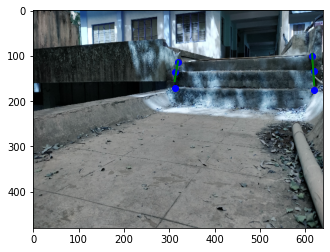

The linear model is: Y = 1.7401e+04 + -46.701X
The linear model is: Y = 703.52 + -2.1427X


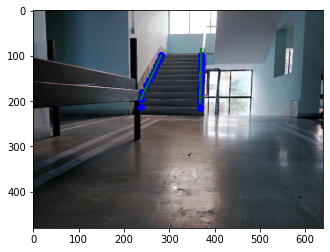

The linear model is: Y = -2634.4 + 10.613X
The linear model is: Y = 115.81 + -6.9361X


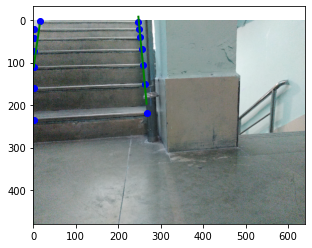

The linear model is: Y = -222.95 + 1.0285X
The linear model is: Y = 44.343 + 1.3345X


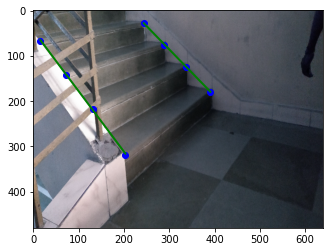

The linear model is: Y = -96.113 + 1.8654X
The linear model is: Y = -173.11 + 113.08X


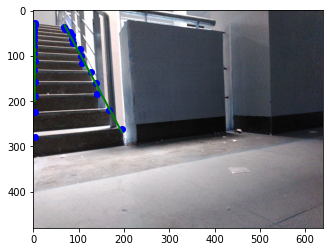

The linear model is: Y = -4275.2 + 7.1938X
The linear model is: Y = 248.21 + -0.81773X


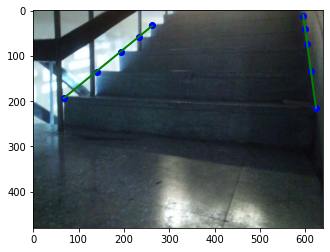

The linear model is: Y = 3.181e+04 + -49.5X
The linear model is: Y = 806.64 + -3.9176X


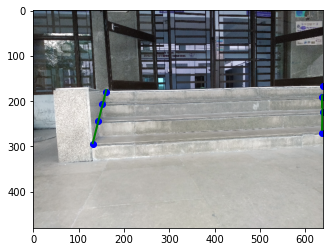

The linear model is: Y = -1023.3 + 3.2558X
The linear model is: Y = 335.09 + -1.1823X


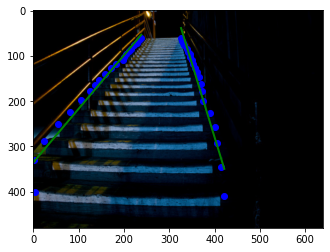

The linear model is: Y = -218.07 + 0.92964X
The linear model is: Y = 347.08 + -0.49324X


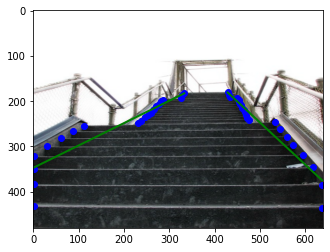

The linear model is: Y = -343.72 + 1.8366X
The linear model is: Y = 902.86 + -3.61X


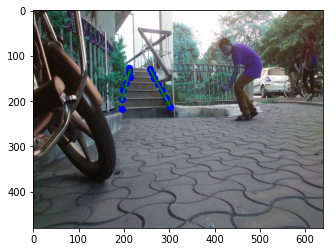

The linear model is: Y = -8504.7 + 27.0X
The linear model is: Y = 1508.2 + -6.25X


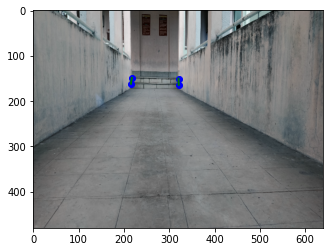

The linear model is: Y = -8.0241e+04 + 125.78X
The linear model is: Y = 1191.0 + -1.8306X


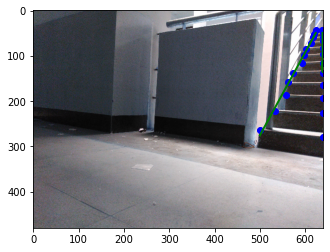

The linear model is: Y = -576.68 + 1.8857X
The linear model is: Y = 901.25 + -3.3778X


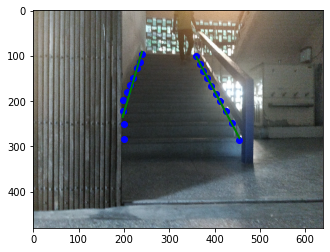

The linear model is: Y = -238.76 + 1.0648X
The linear model is: Y = -708.09 + 3.4923X


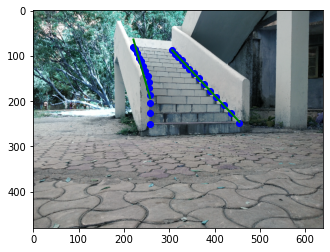

The linear model is: Y = -571.31 + 1.2963X
The linear model is: Y = -6782.1 + 34.0X


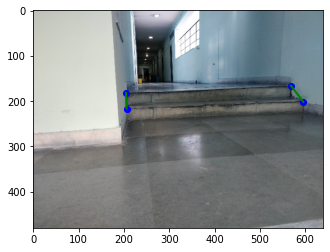

The linear model is: Y = -3169.1 + 5.1528X
The linear model is: Y = 1429.6 + -4.8086X


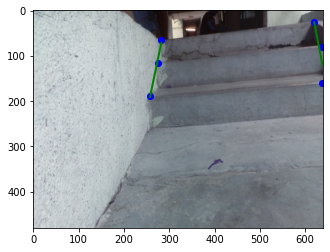

The linear model is: Y = -885.75 + 2.8058X
The linear model is: Y = 671.27 + -2.6171X


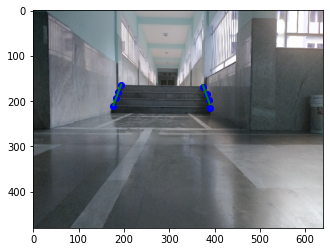

The linear model is: Y = -519.96 + 1.3871X
The linear model is: Y = 765.88 + -2.9358X


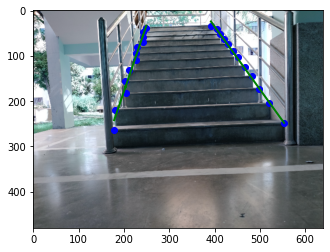

The linear model is: Y = 7860.9 + -12.0X
The linear model is: Y = 486.96 + -155.75X


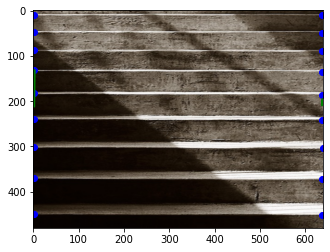

The linear model is: Y = 5524.5 + -11.749X
The linear model is: Y = 822.53 + -1.988X


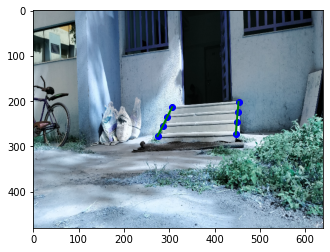

The linear model is: Y = -6353.8 + 10.124X
The linear model is: Y = 4173.4 + -10.592X


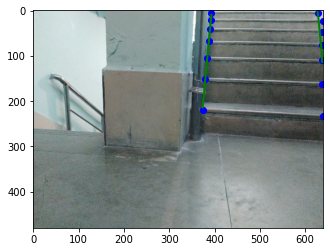

The linear model is: Y = -1.4061e+04 + 36.0X
The linear model is: Y = 1033.8 + -3.4167X


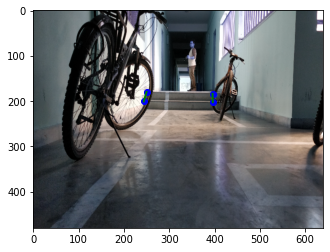

The linear model is: Y = -4188.1 + 12.966X
The linear model is: Y = 3644.1 + -11.992X


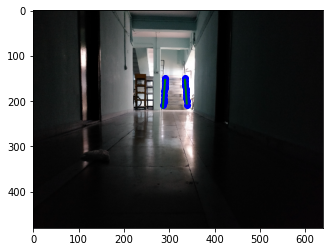

The linear model is: Y = -129.95 + 0.65225X
The linear model is: Y = 331.04 + -0.71742X


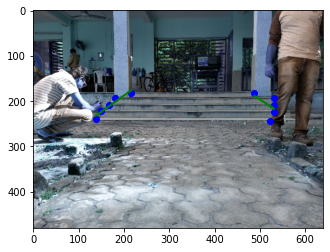

The linear model is: Y = -3.635e+04 + 70.468X
The linear model is: Y = 540.76 + -1.1626X


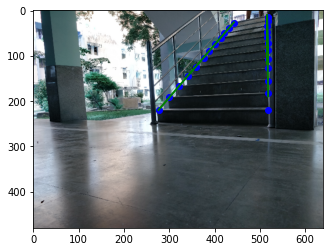

The linear model is: Y = -776.54 + 2.9649X
The linear model is: Y = 884.34 + -2.1475X


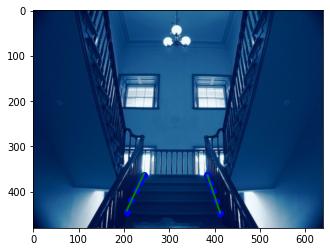

The linear model is: Y = -247.83 + 0.76338X
The linear model is: Y = -255.75 + 1.0762X


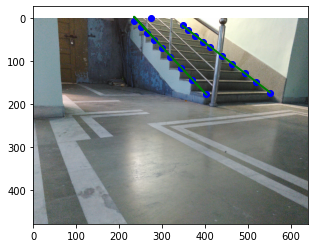

The linear model is: Y = -2499.7 + 5.0X
The linear model is: Y = 1.704e+04 + -54.0X


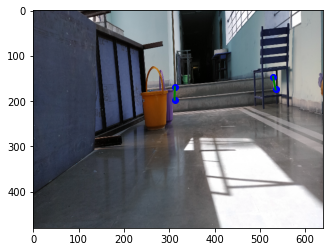

The linear model is: Y = -563.03 + 1.6526X
The linear model is: Y = -1243.2 + 4.4986X


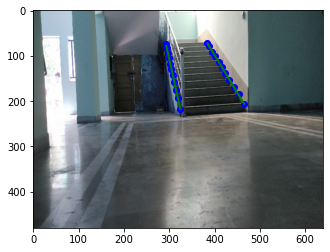

The linear model is: Y = -63.393 + 0.73274X
The linear model is: Y = -4.1281 + 0.92289X


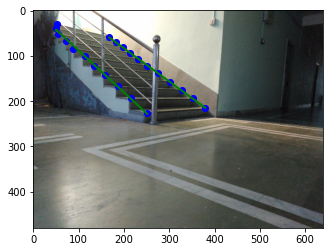

The linear model is: Y = 1491.3 + -2.6364X
The linear model is: Y = 356.9 + -1.2213X


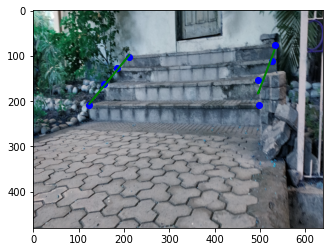

The linear model is: Y = -1780.0 + 4.5564X
The linear model is: Y = 462.44 + -1.5434X


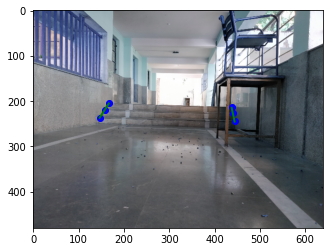

The linear model is: Y = -821.81 + 2.3487X
The linear model is: Y = 527.76 + -1.7601X


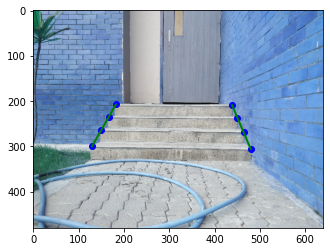

The linear model is: Y = -278.49 + 0.83084X
The linear model is: Y = 342.08 + -7.1096X


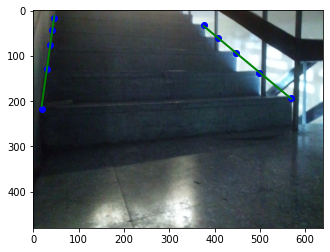

The linear model is: Y = -182.26 + 0.82375X
The linear model is: Y = 282.53 + -8.2804X


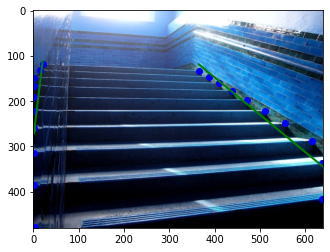

The linear model is: Y = 8705.5 + -29.7X
The linear model is: Y = 1168.2 + -3.8463X


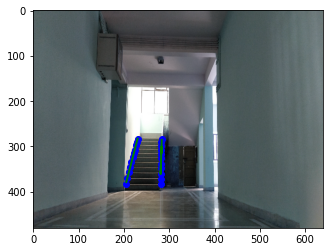

The linear model is: Y = -704.64 + 1.6016X
The linear model is: Y = 754.65 + -9.3297X


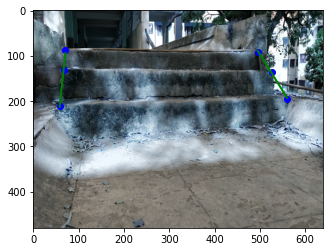

The linear model is: Y = 826.34 + -1.2122X
The linear model is: Y = 503.86 + -0.98544X


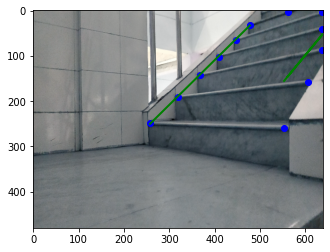

The linear model is: Y = -719.21 + 1.4485X
The linear model is: Y = -1.1814e+04 + 31.5X


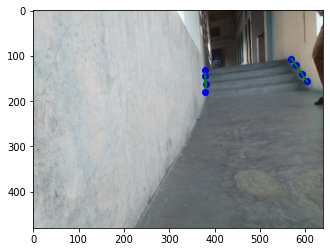

The linear model is: Y = -852.99 + 2.2386X
The linear model is: Y = 285.71 + -1.3997X


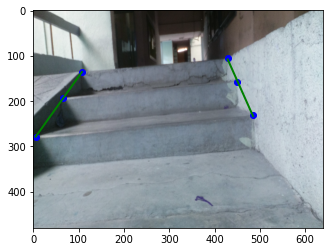

The linear model is: Y = -235.64 + 1.1111X
The linear model is: Y = 405.93 + -0.94444X


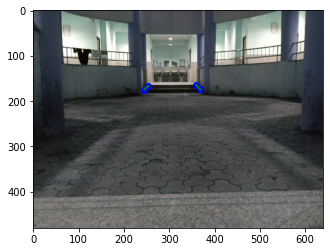

The linear model is: Y = -318.96 + 1.0916X
The linear model is: Y = 836.51 + -6.1659X


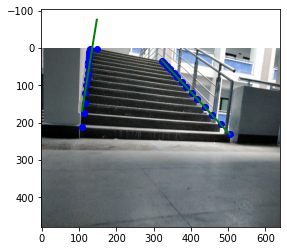

The linear model is: Y = 1144.6 + -2.2747X
The linear model is: Y = 425.43 + -1.0259X


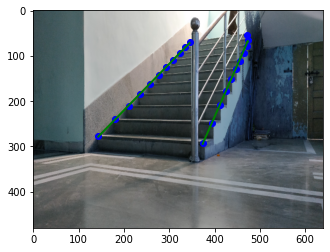

The linear model is: Y = -1038.8 + 2.8264X
The linear model is: Y = 794.44 + -2.2605X


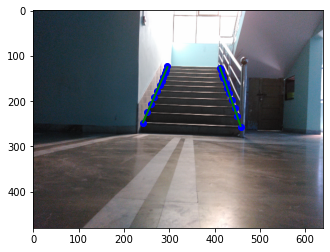

The linear model is: Y = -785.31 + 2.2909X
The linear model is: Y = -1603.5 + 7.5909X


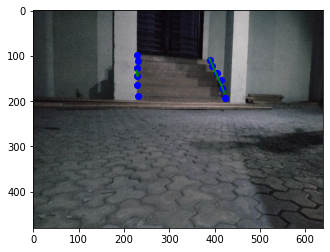

The linear model is: Y = -971.07 + 3.2789X
The linear model is: Y = 478.15 + -1.3005X


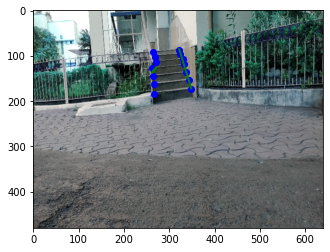

The linear model is: Y = -1667.5 + 3.7589X
The linear model is: Y = 2160.4 + -6.7429X


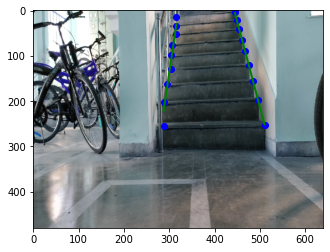

The linear model is: Y = -663.67 + 2.5654X
The linear model is: Y = 988.07 + -2.3992X


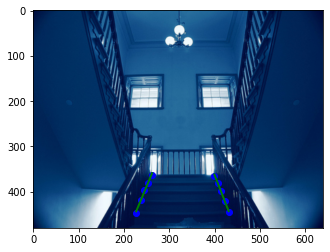

The linear model is: Y = -551.39 + 1.8269X
The linear model is: Y = 589.08 + -2.0139X


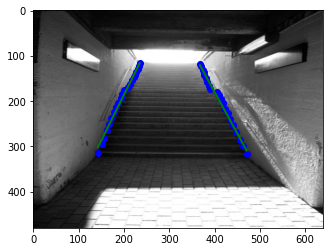

The linear model is: Y = -1841.6 + 3.8378X
The linear model is: Y = 208.86 + -3.5619X


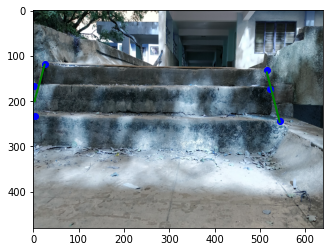

The linear model is: Y = -3522.5 + 12.014X
The linear model is: Y = 1063.0 + -5.4968X


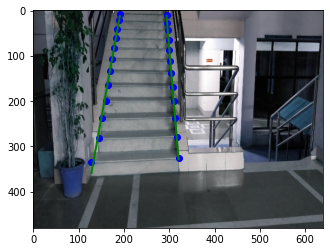

The linear model is: Y = 8.6522e+04 + -135.5X
The linear model is: Y = 353.04 + -75.5X


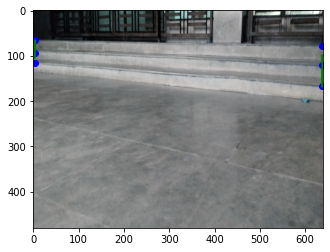

The linear model is: Y = 1875.7 + -3.5556X
The linear model is: Y = 372.42 + -0.91004X


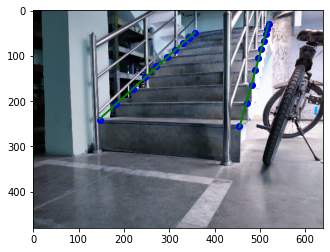

The linear model is: Y = 5.9574e+04 + -93.0X
The linear model is: Y = 580.19 + -1.5306X


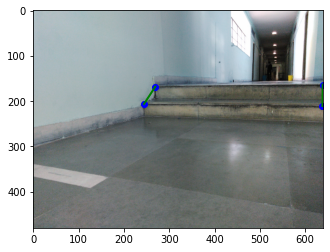

The linear model is: Y = 4.7314e+04 + -74.0X
The linear model is: Y = 113.09 + 4.5X


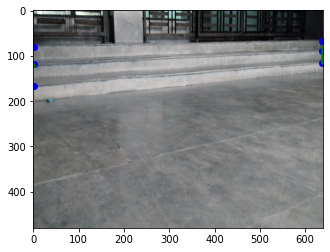

The linear model is: Y = -498.43 + 1.3299X
The linear model is: Y = -5727.8 + 26.62X


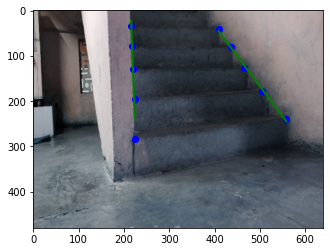

The linear model is: Y = 7424.2 + -15.57X
The linear model is: Y = 424.19 + -1.2367X


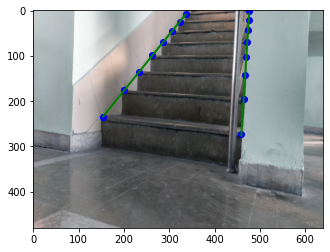

The linear model is: Y = -822.28 + 1.718X
The linear model is: Y = 387.95 + -1.7766X


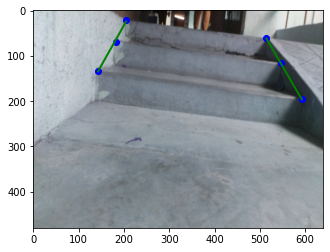

The linear model is: Y = 186.5 + 0.0X
The linear model is: Y = 349.86 + -0.39266X


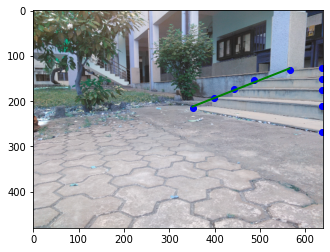

The linear model is: Y = 582.42 + -1.0929X
The linear model is: Y = 298.78 + -0.5812X


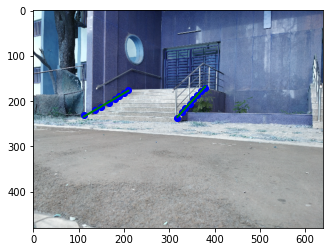

The linear model is: Y = -3.5649e+04 + 56.091X
The linear model is: Y = 463.61 + -0.60051X


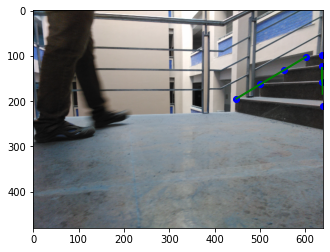

The linear model is: Y = -515.78 + 1.4785X
The linear model is: Y = 454.37 + -0.57117X


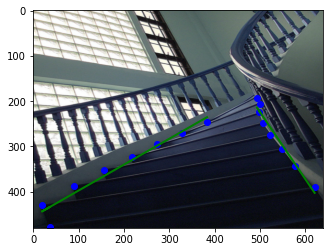

The linear model is: Y = -266.07 + 1.2066X
The linear model is: Y = -500.07 + 3.4805X


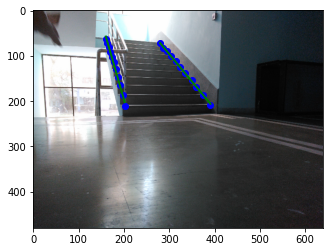

The linear model is: Y = -232.38 + 0.70838X
The linear model is: Y = 516.96 + -128.81X


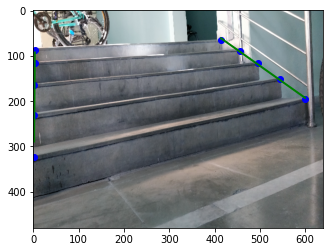

The linear model is: Y = -654.44 + 1.3203X
The linear model is: Y = 1359.6 + -4.509X


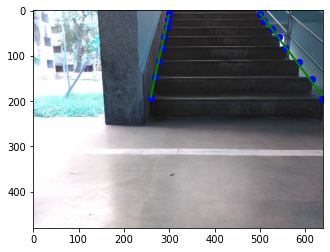

The linear model is: Y = -594.48 + 1.2948X
The linear model is: Y = 640.64 + -146.23X


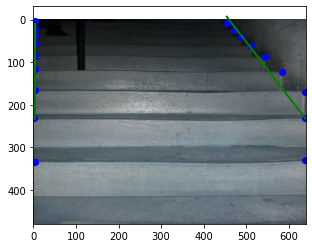

The linear model is: Y = -5.4451e+04 + 99.357X
The linear model is: Y = 41.544 + 96.75X


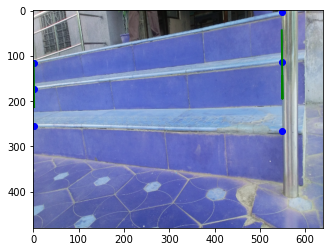

The linear model is: Y = 9064.4 + -28.348X
The linear model is: Y = 1352.0 + -5.5936X


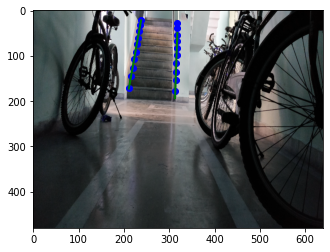

The linear model is: Y = -1057.4 + 2.2123X
The linear model is: Y = 244.3 + -0.84283X


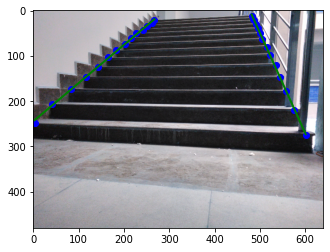

The linear model is: Y = -4.2503e+04 + 67.0X
The linear model is: Y = 631.51 + -2.5115X


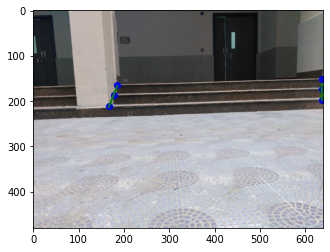

The linear model is: Y = -236.37 + 1.0361X
The linear model is: Y = -319.92 + 2.3111X


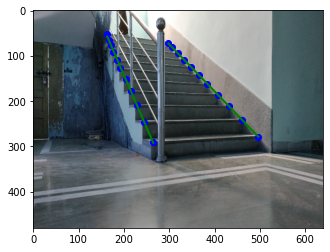

The linear model is: Y = -1034.3 + 2.5923X
The linear model is: Y = 820.42 + -2.741X


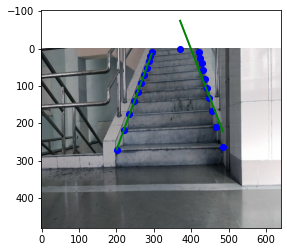

The linear model is: Y = 897.95 + -1.8691X
The linear model is: Y = 310.01 + -0.92068X


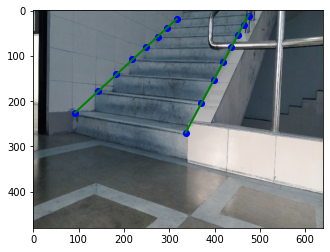

The linear model is: Y = -1072.3 + 2.31X
The linear model is: Y = 289.34 + -1.4213X


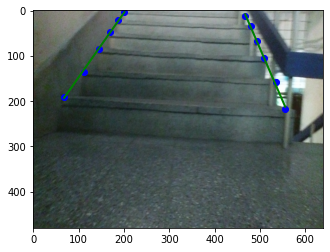

In [ ]:
for i in list1:
  list_1=[]
  list_2=[]
  list_3=[]
  list_4=[]
  path1=dataroot+i
  path2=dataroot+i.split('.')[0]+'.json'
  temp1=json.load(open(path2))['shapes']
  image=cv2.imread(path1)
  plt.imshow(image)
  passing_list=[] 
  area2=0
  for i in range(len(json.load(open(path2))['shapes'])) :
    k=temp1[i]
    area1=PolygonArea(k['points'])
    if area1>area2:
      g=k['points']
    area2=area1
  #g
  for n in range(int(len(g)/2)):
    list_1.append(g[n][0])
    list_2.append(g[n][1])
    list_3.append(g[-n-1][0])
    list_4.append(g[-n-1][1])
    grand_list=[[list_1,list_2],[list_3,list_4]]
  for each_l in grand_list:
    x=np.array(each_l[0]).reshape((-1,1))
    y=np.array(each_l[1]).reshape((-1,1))
    reg = LinearRegression()
    reg.fit(x,y)
    plt.scatter(
        x,
        y,
        c='blue'
    )
    print("The linear model is: Y = {:.5} + {:.5}X".format(np.squeeze(reg.intercept_),np.squeeze(reg.coef_)))
    predictions=np.squeeze(reg.intercept_)+np.squeeze(reg.coef_) *x
    passing_list1=[np.squeeze(x.min()).tolist(),np.squeeze(predictions[0]).tolist(),np.squeeze(x[-1]).tolist(),np.squeeze(predictions[-1]).tolist()]
    passing_list.append(passing_list1)  
    plt.plot(
        x,
        predictions,
        c='green',
        linewidth=2
    )
    plt.show()


The linear model is: Y = -63.259 + 0.74735X


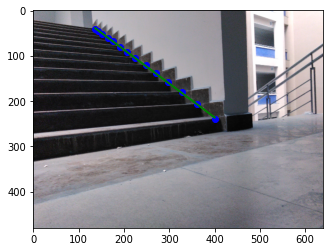

The linear model is: Y = 103.5 + 0.0X


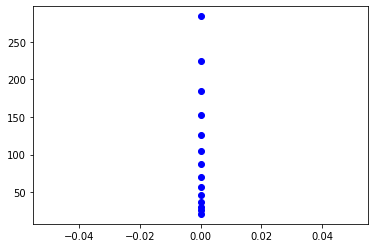

In [ ]:
i='1329.png'
list_1=[]
list_2=[]
list_3=[]
list_4=[]
path1=dataroot+i
path2=dataroot+i.split('.')[0]+'.json'
temp1=json.load(open(path2))['shapes']
image=cv2.imread(path1)
plt.imshow(image)
passing_list=[] 
area2=0
for i in range(len(json.load(open(path2))['shapes'])) :
  k=temp1[i]
  area1=PolygonArea(k['points'])
  if area1>area2:
    g=k['points']
  area2=area1
#g
for n in range(int(len(g)/2)):
  list_1.append(g[n][0])
  list_2.append(g[n][1])
  list_3.append(g[-n-1][0])
  list_4.append(g[-n-1][1])
  grand_list=[[list_1,list_2],[list_3,list_4]]
for each_l in grand_list:
  x=np.array(each_l[0]).reshape((-1,1))
  y=np.array(each_l[1]).reshape((-1,1))
  reg = LinearRegression()
  reg.fit(x,y)
  plt.scatter(
      x,
      y,
      c='blue'
  )
  print("The linear model is: Y = {:.5} + {:.5}X".format(np.squeeze(reg.intercept_),np.squeeze(reg.coef_)))
  predictions=np.squeeze(reg.intercept_)+np.squeeze(reg.coef_) *x
  passing_list1=[np.squeeze(x.min()).tolist(),np.squeeze(predictions[np.argmin(x)]).tolist(),np.squeeze(x.max()).tolist(),np.squeeze(np.argmax(x)).tolist()]
  passing_list.append(passing_list1)  
  plt.plot(
      x,
      predictions,
      c='green',
      linewidth=2
  )
  plt.show()

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
The linear model is: Y = 103.5 + 0.0X


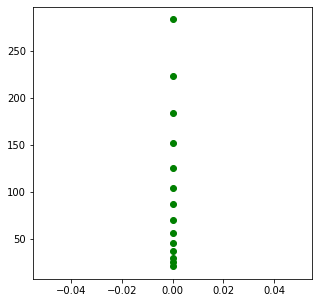

In [ ]:
 plt.figure(figsize=(5,5))
 plt.scatter(
      list_3,
      list_4,
      c='green'
  )
 print(list_3)
x=np.array(list_3).reshape((-1,1))
y=np.array(list_4).reshape((-1,1))
reg = LinearRegression()
reg.fit(x,y)
print("The linear model is: Y = {:.5} + {:.5}X".format(np.squeeze(reg.intercept_),np.squeeze(reg.coef_)))
# x = np.linspace(0,30,31)
# print(np.squeeze(reg.intercept_))
# print(np.squeeze(reg.coef_))
y= reg.intercept_[0]+reg.coef_[0][0]*x
# print(x,y)
plt.plot(
    x,
    y,
    c='blue'
)
plt.show()

In [ ]:
i='1329.png'
list_1=[]
list_2=[]
list_3=[]
list_4=[]
path1=dataroot+i
path2=dataroot+i.split('.')[0]+'.json'
temp1=json.load(open(path2))['shapes']
image=cv2.imread(path1)
temp1
image=cv2.imread(path1)
plt.imshow(image)
passing_list=[]
area2=0
for i in range(len(json.load(open(path2))['shapes'])) :
  k=temp1[i]
  area1=PolygonArea(k['points'])
  if area1>area2:
    g=k['points']
  area2=area1

[{'flags': {},
  'group_id': None,
  'label': '1',
  'points': [[400.24873096446703, 238.57868020304568],
   [361.16243654822335, 206.09137055837564],
   [327.1522842639594, 180.71065989847716],
   [297.2030456852792, 157.36040609137055],
   [269.79187817258884, 138.0710659898477],
   [248.97969543147207, 120.30456852791879],
   [224.61421319796955, 105.0761421319797],
   [206.84771573604064, 91.87817258883248],
   [191.11167512690355, 79.69543147208122],
   [175.88324873096445, 67.51269035532995],
   [165.73096446700507, 60.40609137055838],
   [152.0253807106599, 51.776649746192895],
   [143.9035532994924, 44.162436548223354],
   [136.7969543147208, 40.101522842639596],
   [3.2944162436548226, 23.3502538071066],
   [3.2944162436548226, 25.888324873096447],
   [3.2944162436548226, 30.456852791878173],
   [3.8020304568527905, 38.578680203045685],
   [3.8020304568527905, 47.71573604060914],
   [4.3096446700507585, 57.86802030456853],
   [4.3096446700507585, 70.55837563451777],
   [5.3248

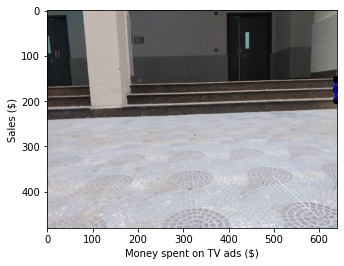

In [ ]:
predictions = reg.predict(x)
plt.imshow(image)
plt.scatter(
    x,
    y,
    c='black'
)
plt.plot(
    x,
    predictions,
    c='blue',
    linewidth=2
)
plt.xlabel("Money spent on TV ads ($)")
plt.ylabel("Sales ($)")
plt.show()

cpu
